In [1]:
import os
import json
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from dotenv import load_dotenv

from sklearn.decomposition import PCA
from sklearn.cluster import (
    KMeans,
    MiniBatchKMeans,
    DBSCAN,
    OPTICS,
    MeanShift,
    estimate_bandwidth,
    SpectralClustering,
    AgglomerativeClustering,
    FeatureAgglomeration,
    Birch
)
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from PIL import Image
import umap
from sklearn.metrics import silhouette_score
from kneed import KneeLocator

import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import umap
from collections import defaultdict


In [2]:
load_dotenv()

folder_path = os.getenv('path_vrubel_pics')

resnet50_vecs = os.getenv('resnet50_vecs_vrubel')
vit_vecs = os.getenv('vit_vecs_vrubel')
siglip_vecs = os.getenv('siglip_vecs_vrubel')
clip_vecs = os.getenv('clip_vecs_vrubel')
vgg19_vecs = os.getenv('vgg19_vecs_vrubel')

path_pics = os.getenv('path_vrubel_pics')
# tags_goya_path = os.getenv('tags_goya_path')

In [3]:
# tags_path = os.getenv('tags_munch_path')

In [3]:
with open(resnet50_vecs, 'r', encoding='utf-8') as f:
    vecs_resnet50 = json.load(f)
    
with open(vit_vecs, 'r', encoding='utf-8') as f:
    vecs_vit = json.load(f)
    
with open(siglip_vecs, 'r', encoding='utf-8') as f:
    vecs_siglip = json.load(f)
    
with open(clip_vecs, 'r', encoding='utf-8') as f:
    vecs_clip = json.load(f)
    
with open(vgg19_vecs, 'r', encoding='utf-8') as f:
    vecs_vgg19 = json.load(f)

## Векторы siglip

In [5]:
filenames = list(i for i in vecs_siglip)
vectors = np.array([np.array(v).flatten() for v in vecs_siglip.values()])

#### KMeans

In [6]:
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
labels_kmeans = kmeans.fit_predict(vectors)

pca = PCA(n_components=2)
reduced_vectors = pca.fit_transform(vectors)

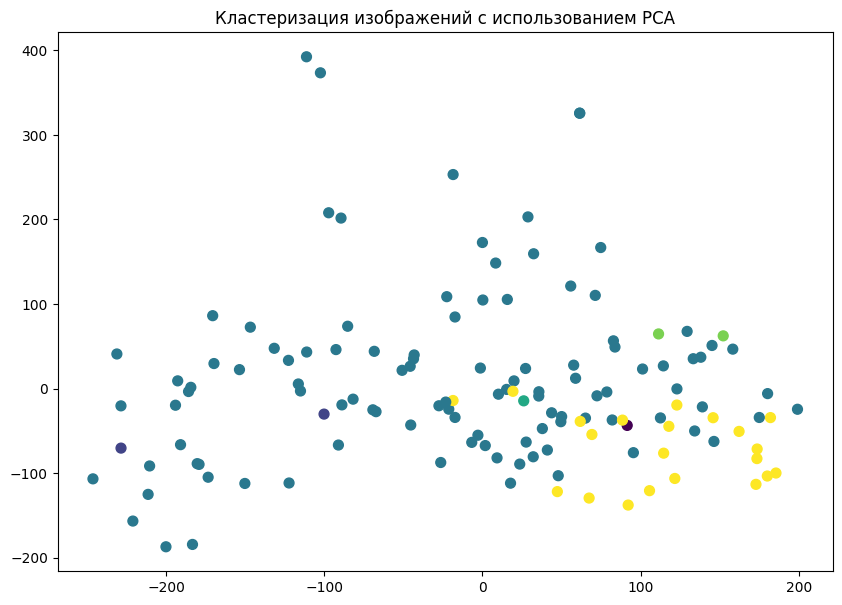

In [7]:
plt.figure(figsize=(10, 7))
scatter = plt.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], c=labels_kmeans, cmap='viridis', s=50)

# for i, label in enumerate(filenames):
#     x, y = reduced_vectors[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.title('Кластеризация изображений с использованием PCA')
plt.show()

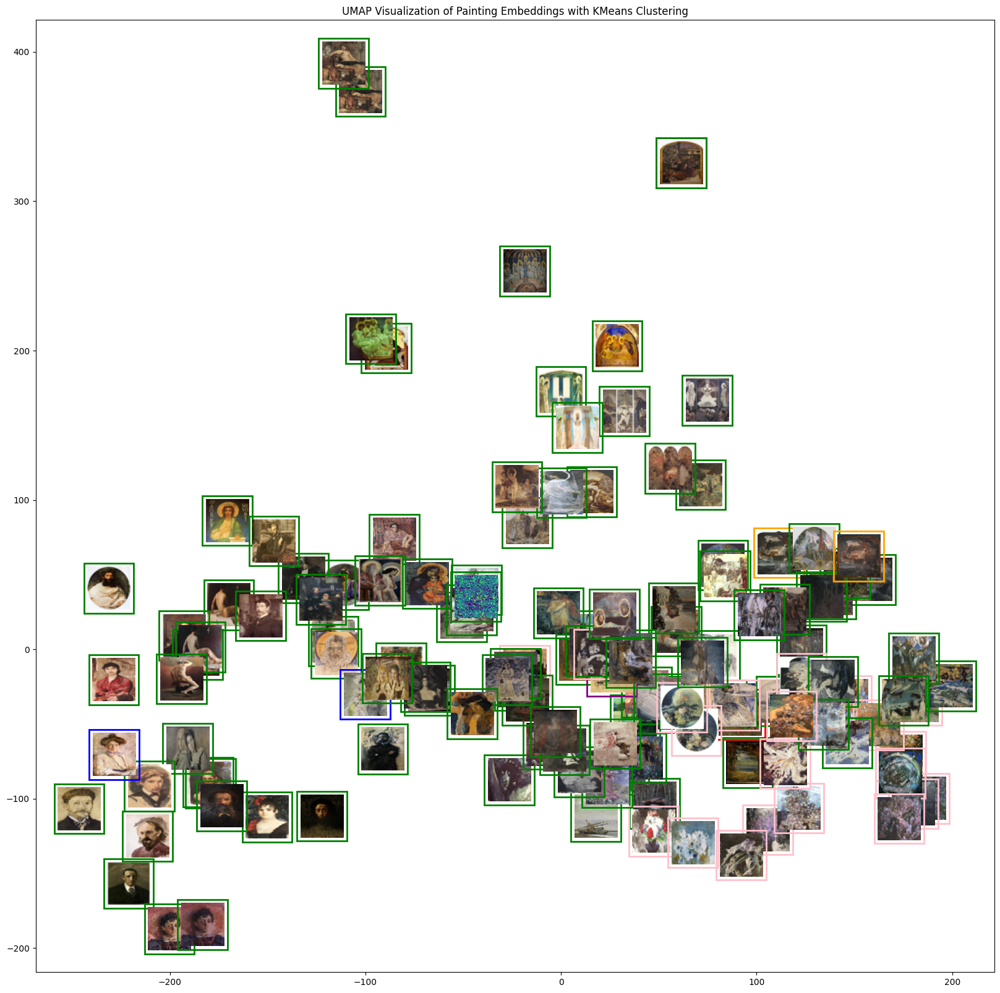

In [8]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange',  # Cluster 4
    'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(reduced_vectors):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[labels_kmeans[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Mean Shift

In [10]:
X_scaled = StandardScaler().fit_transform(vectors)

In [11]:
bandwidth = estimate_bandwidth(X_scaled, quantile=0.2, n_samples=len(X_scaled))
print(f"Estimated bandwidth: {bandwidth}")

Estimated bandwidth: 537.8475065839085


In [17]:
ms = MeanShift(bin_seeding=True)
labels_ms = ms.fit_predict(X_scaled)

In [18]:
unique_labels = np.unique(labels_ms)
n_clusters = len(unique_labels)
print(f"Найдено кластеров: {n_clusters}")

Найдено кластеров: 1


/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


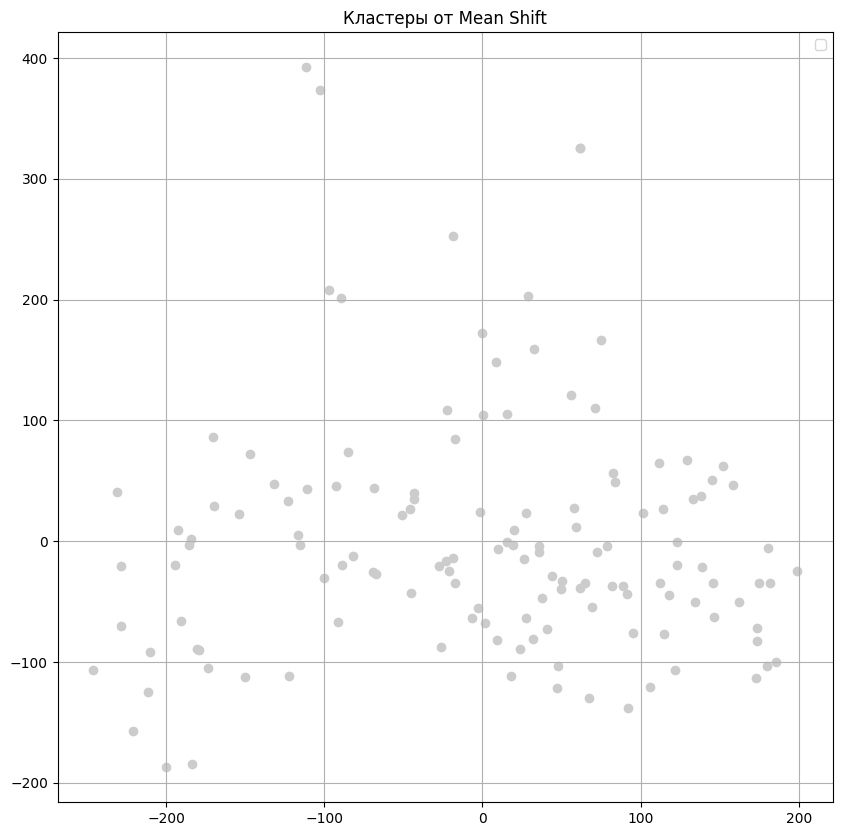

In [19]:
cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
colors = cmap(np.arange(n_clusters))

plt.figure(figsize=(10, 10))
for idx, label in enumerate(unique_labels):
    mask = labels_ms == label
    plt.scatter(reduced_vectors[mask, 0], reduced_vectors[mask, 1], 
                color=colors[idx]) #, label=f'Кластер {label}', s=50)

plt.title("Кластеры от Mean Shift")

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.legend()
plt.grid(True)
plt.show()

#### Spectral Clustering

In [20]:
spectral = SpectralClustering(
                            n_clusters=4, 
                            affinity='nearest_neighbors', 
                            assign_labels='kmeans', 
                            random_state=42
                            )
clusters = spectral.fit_predict(vectors)

In [21]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

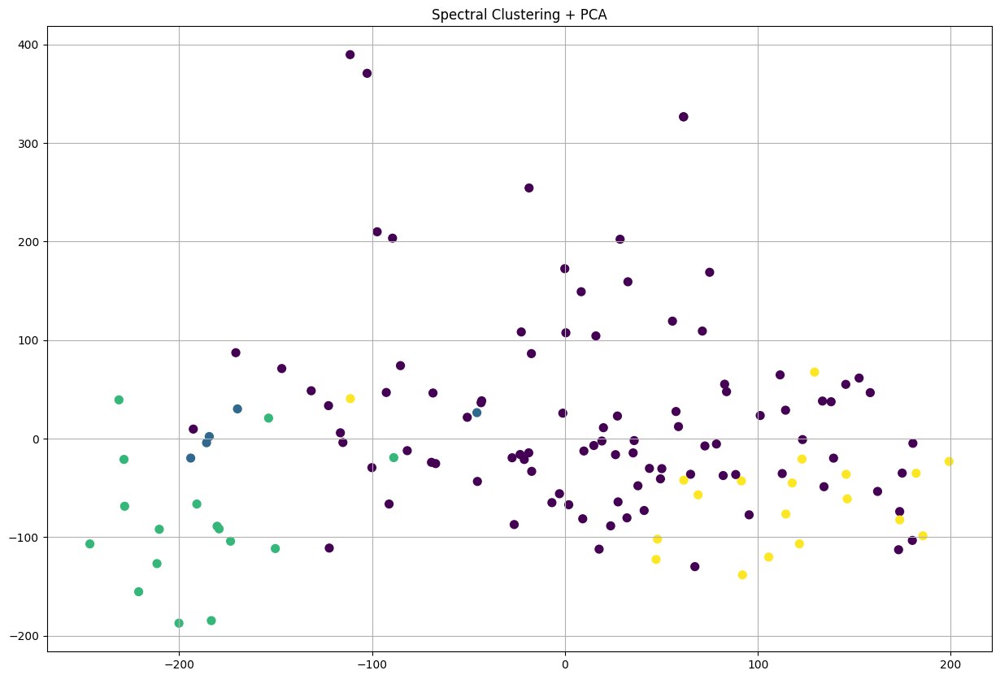

In [22]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Spectral Clustering + PCA')
plt.grid(True)
plt.show()

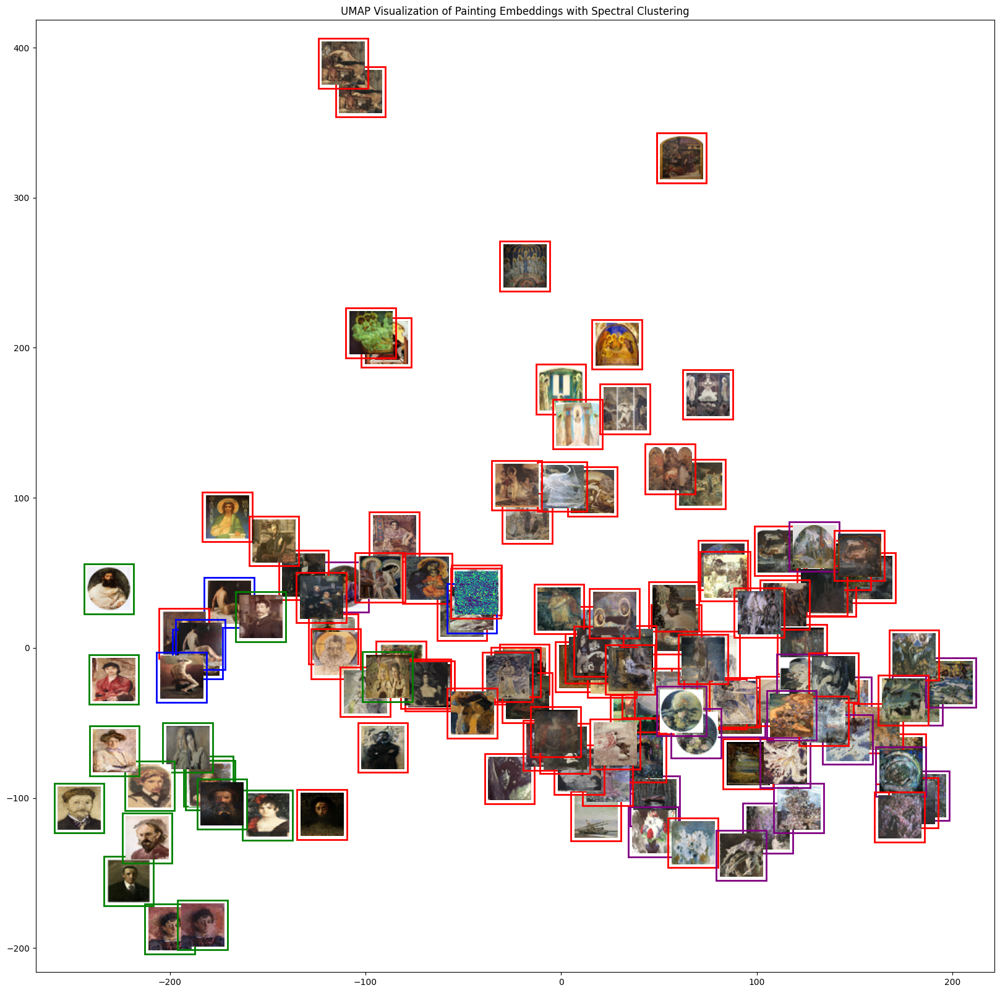

In [23]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Spectral Clustering")
plt.show()

#### GaussianMixture

In [24]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

In [25]:
gmm = GaussianMixture(n_components=2, random_state=0)
gmm.fit(X_reduced)
clusters_gmm = gmm.predict(X_reduced)

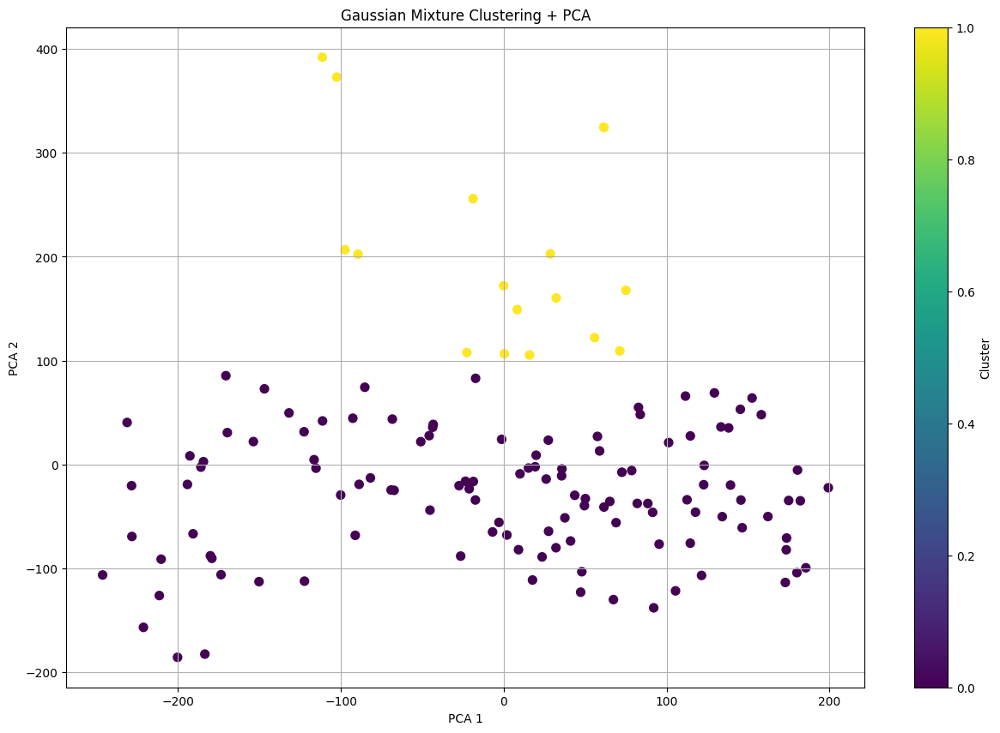

In [26]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_gmm, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Gaussian Mixture Clustering + PCA')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

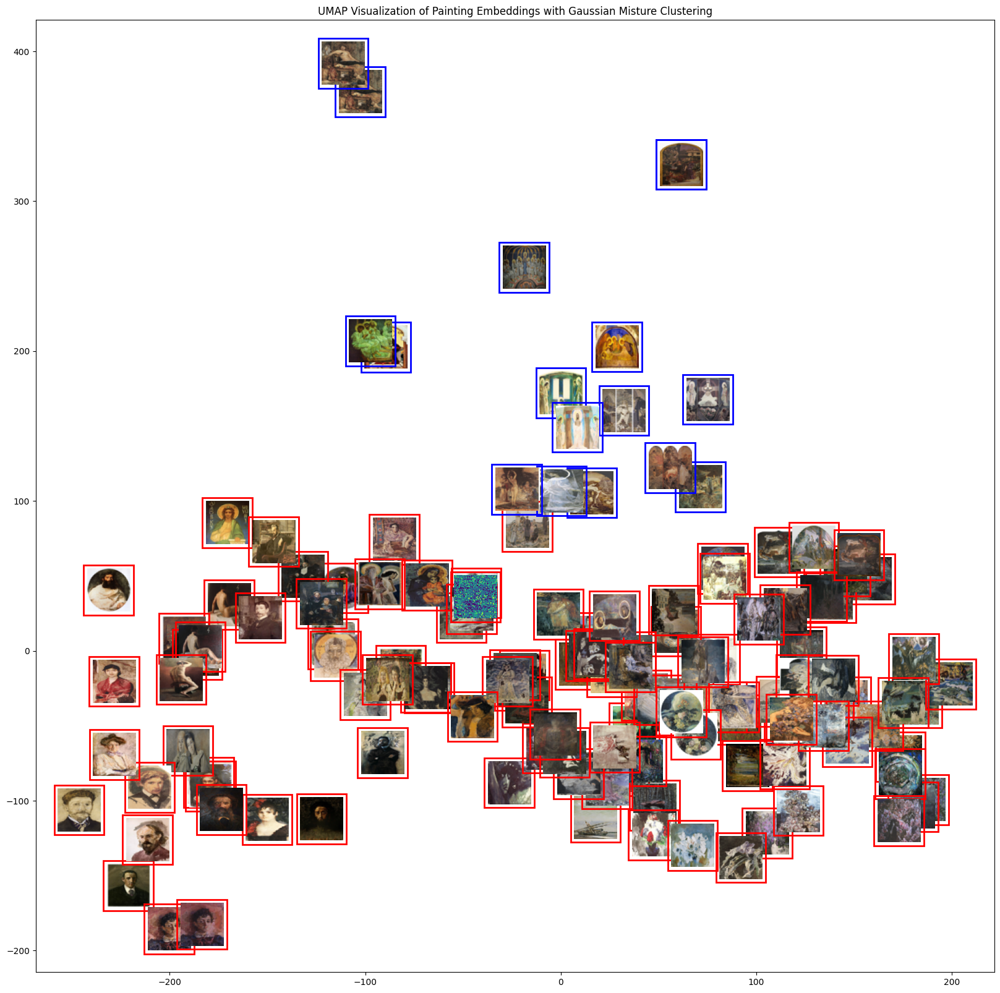

In [27]:
cluster_colors = [
    'red',    # Cluster 0
    'blue'   # Cluster 1
    # 'green',  # Cluster 2
    # 'purple', # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_gmm[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Gaussian Misture Clustering")
plt.show()

#### Birch

In [28]:
birch = Birch(n_clusters=4)
clusters_birch = birch.fit_predict(vectors)

In [29]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

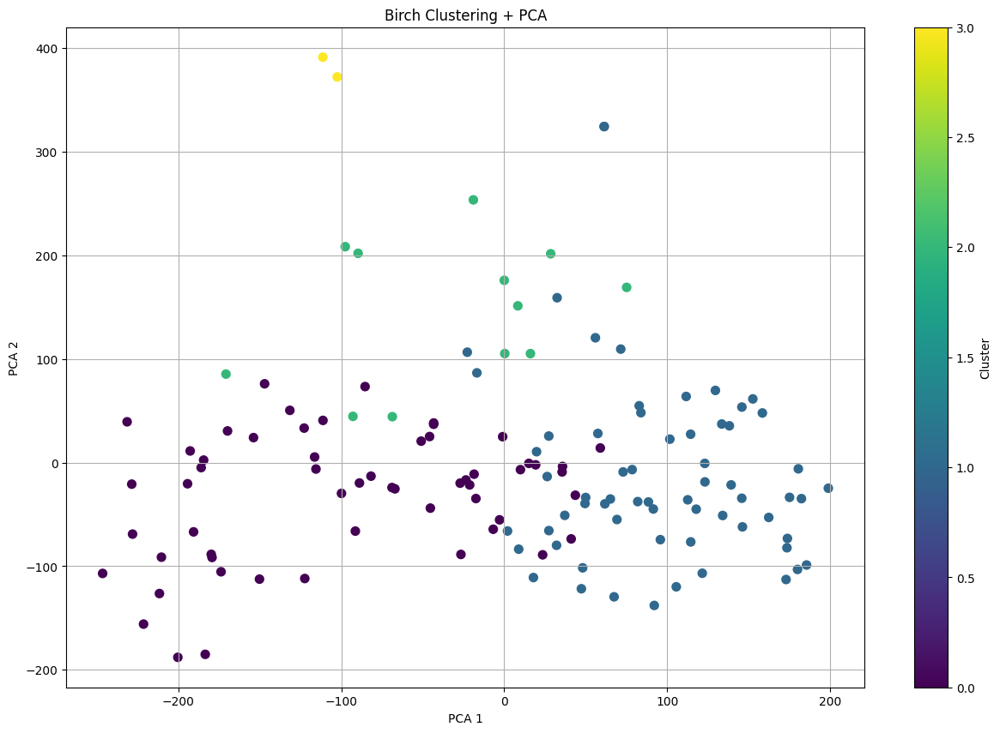

In [30]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_birch, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Birch Clustering + PCA')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

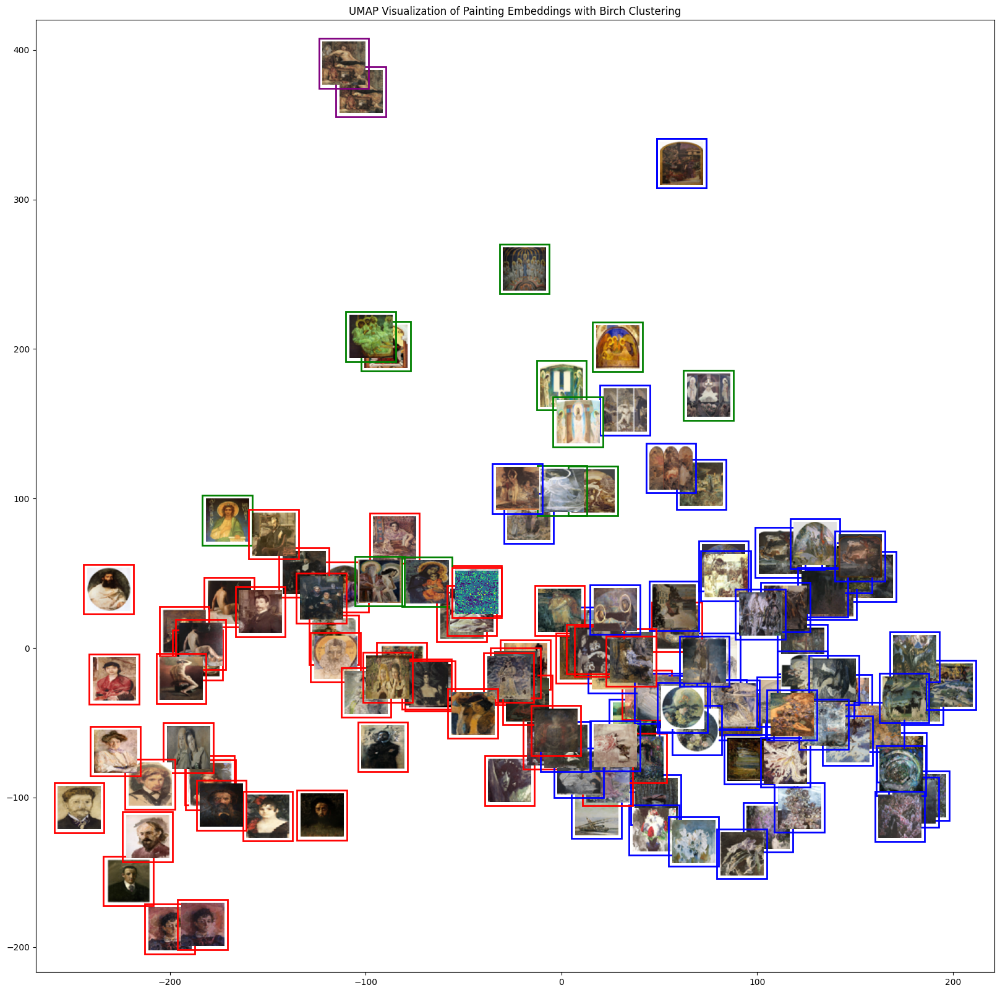

In [31]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_birch[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Birch Clustering")
plt.show()

#### Кластеризация с Umap

In [32]:
filenames = list(vecs_siglip.keys())
vecs = np.array([vecs_siglip[fname][0] for fname in filenames]).astype(np.float32)

pca = PCA(n_components=3)
vecs = pca.fit_transform(vecs)

vector_lengths = [vecs[i].shape[0] for i in range(len(vecs))]

In [33]:
reducer = umap.UMAP(n_neighbors=2,
                    n_components=2, 
                    metric='cosine', 
                    min_dist=0.35,
                    spread=0.35,
                    random_state=42)

embeddings_2d = reducer.fit_transform(vecs)

kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(embeddings_2d)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


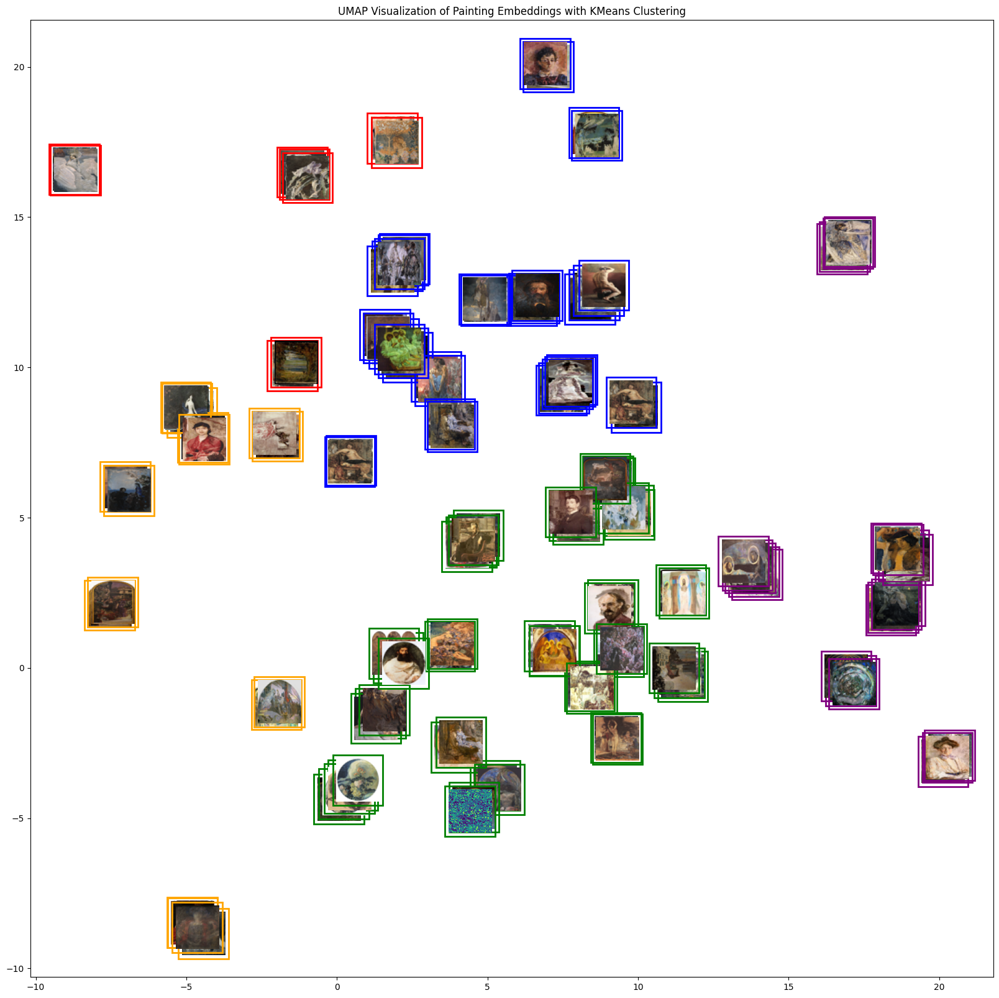

In [34]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange'  # Cluster 4
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(embeddings_2d):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[cluster_labels[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Теги и вектора siglip

In [92]:
colors = []
for filename in vecs_siglip.keys():
    if filename.split('_')[0] == 'yyyy': # blue - before treatment
        # colors.append('blue')
        continue
    elif int(filename.split('_')[0]) < 1908:
        colors.append('blue')
    else:
        colors.append('red') # red - after treatment
        
len(colors)

211

In [93]:
labels = []
for i in vecs_siglip.keys():
    if i.split('_')[0] != 'yyyy':
        labels.append(i)
        
len(labels)

211

In [94]:
X = []
for key, vec in vecs_siglip.items():
    if 'yyyy' not in key:  # Пропускаем ключи, содержащие 'yyyy'
        if isinstance(vec[0], (list, tuple)):
            X.append(vec[0])
        else:
            X.append(vec)

len(X)

211

In [ ]:
# X = [vec[0] if isinstance(vec[0], (list, tuple)) else vec for vec in vecs_siglip.values()]

In [95]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(X)

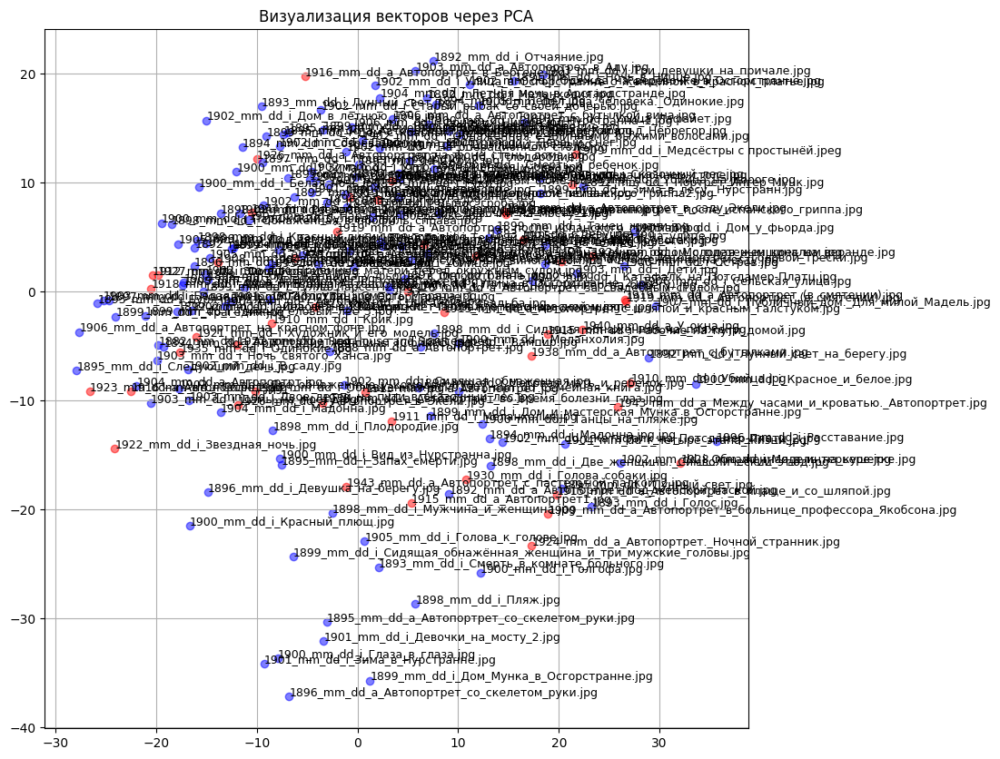

In [96]:
plt.figure(figsize=(10, 10))
for i, label in enumerate(labels):
    x, y = X_reduced[i]
    plt.scatter(x, y, color=colors[i], alpha=0.5)
    plt.text(x + 0.02, y + 0.02, label, fontsize=9)

plt.title("Визуализация векторов через PCA")
plt.grid(True)
plt.show()

In [ ]:
data_dict = {}

with open(tags_path, 'r', encoding='utf-8') as file:
    for line in file:
        line = line.strip()
        if '—' in line:
            key, value = line.split('—', 1)
            key = key.strip()a
            value = value.strip()
            data_dict[key] = value.split(' ')

len(data_dict)

212

In [103]:
all_dict = {}

for i in vecs_siglip:
    try:
        all_dict[i] = {'vec': vecs_siglip[i],
                    'tags': data_dict[i]
        }
    except:
        continue
    
len(all_dict)

210

In [105]:
with open("clusterisation_data_munch.json", "w", encoding="utf-8") as f:
    json.dump(all_dict, f, default=str, ensure_ascii=False, indent=4)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


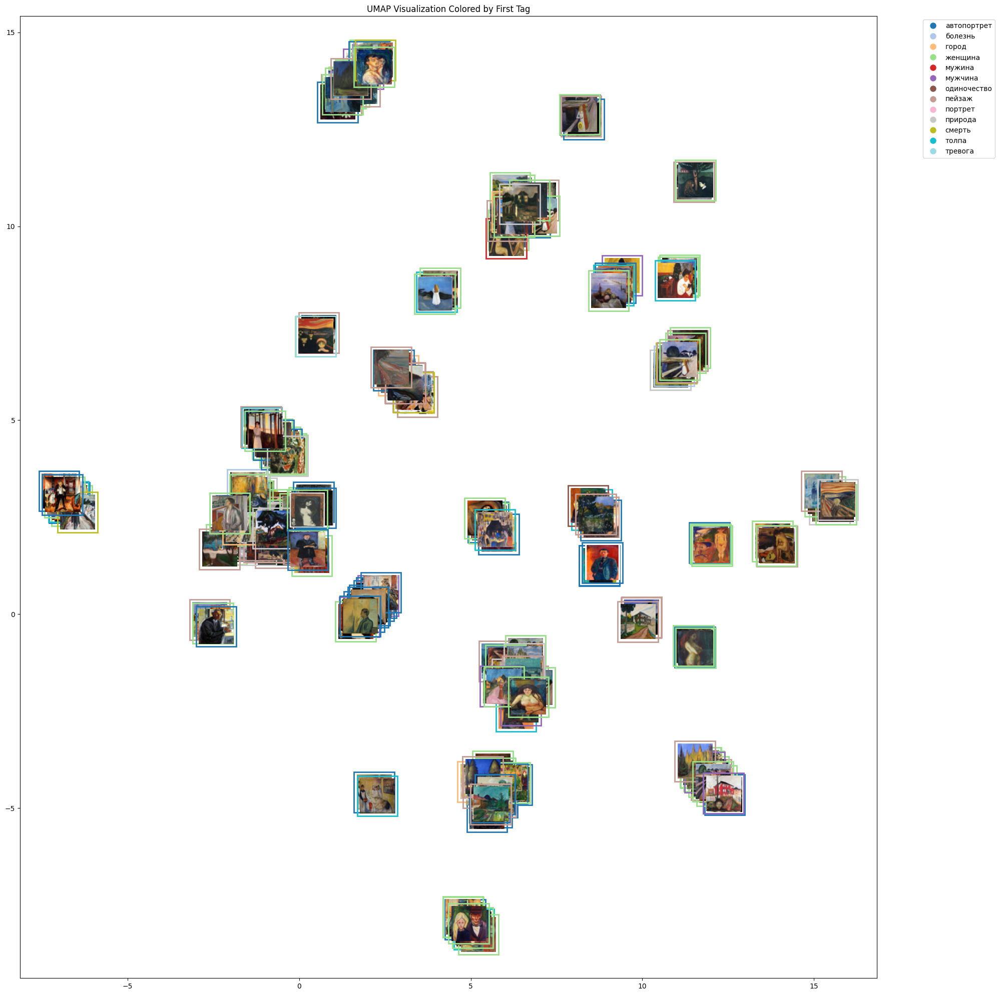

In [109]:
filenames = list(all_dict.keys())
vecs = np.array([all_dict[fname]['vec'][0] for fname in filenames]).astype(np.float32)

vector_lengths = [vec.shape[0] for vec in vecs]
if len(set(vector_lengths)) > 1:
    max_length = max(vector_lengths)
    vecs_padded = np.zeros((len(filenames), max_length), dtype=np.float32)
    for i, vec in enumerate(vecs):
        vecs_padded[i, :len(vec)] = vec
    vecs = vecs_padded

reducer = umap.UMAP(
            n_neighbors=2,
            n_components=2,
            metric='cosine', 
            min_dist=0.35,
            spread=0.35,
            random_state=42
            )
embeddings_2d = reducer.fit_transform(vecs)

all_tags = set()
for fname, data in all_dict.items():
    tags = data['tags']
    if tags: 
        first_tag = tags[0] if isinstance(tags, (list, tuple)) else tags
        all_tags.add(first_tag)

unique_tags = sorted(list(all_tags))
tag_colors = plt.cm.tab20(np.linspace(0, 1, len(unique_tags)))
tag_to_color = {tag: color for tag, color in zip(unique_tags, tag_colors)}

plt.figure(figsize=(20, 20))
ax = plt.gca()

for i, (x, y) in enumerate(embeddings_2d):
    fname = filenames[i]
    path = os.path.join(path_munch_pics, fname)
    
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        
        tags = all_dict[fname]['tags']
        if tags:
            first_tag = tags[0] if isinstance(tags, (list, tuple)) else tags
            color = tag_to_color.get(first_tag, 'gray')
        else:
            color = 'gray'
        
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(
                edgecolor=color,
                linewidth=2,
                facecolor='none'
            )
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

legend_handles = []
for tag, color in tag_to_color.items():
    legend_handles.append(plt.Line2D([0], [0], marker='o', color='w', 
                                markerfacecolor=color, markersize=10, label=tag))
plt.legend(handles=legend_handles, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)
plt.title("UMAP Visualization Colored by First Tag")
plt.tight_layout()
plt.show()

## Векторы ViT

In [35]:
# filenames = list(i.split('_')[0] for i in vecs_vit)
filenames = list(i for i in vecs_vit)
vectors = np.array([np.array(v).flatten() for v in vecs_vit.values()])

In [36]:
colors = []
for filename in vecs_vit.keys():
    if filename.split('_')[0] == 'yyyy': # blue - before treatment
        colors.append('blue')
    elif int(filename.split('_')[0]) < 1819:
        colors.append('blue')
    else:
        colors.append('red') # red - after treatment

#### KMeans

In [37]:
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
labels_kmeans = kmeans.fit_predict(vectors)

pca = PCA(n_components=2)
reduced_vectors = pca.fit_transform(vectors)

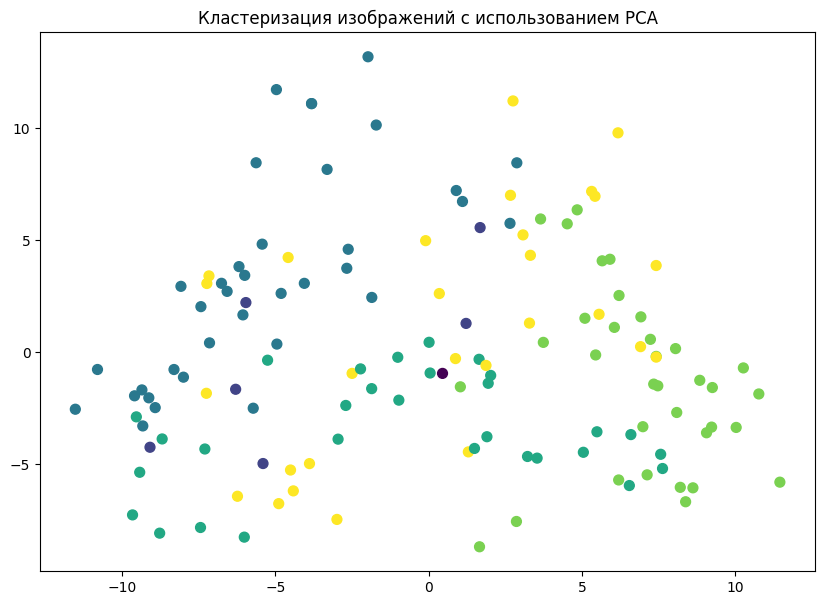

In [38]:
plt.figure(figsize=(10, 7))
scatter = plt.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], c=labels_kmeans, cmap='viridis', s=50)

# for i, label in enumerate(filenames):
#     x, y = reduced_vectors[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.title('Кластеризация изображений с использованием PCA')
plt.show()

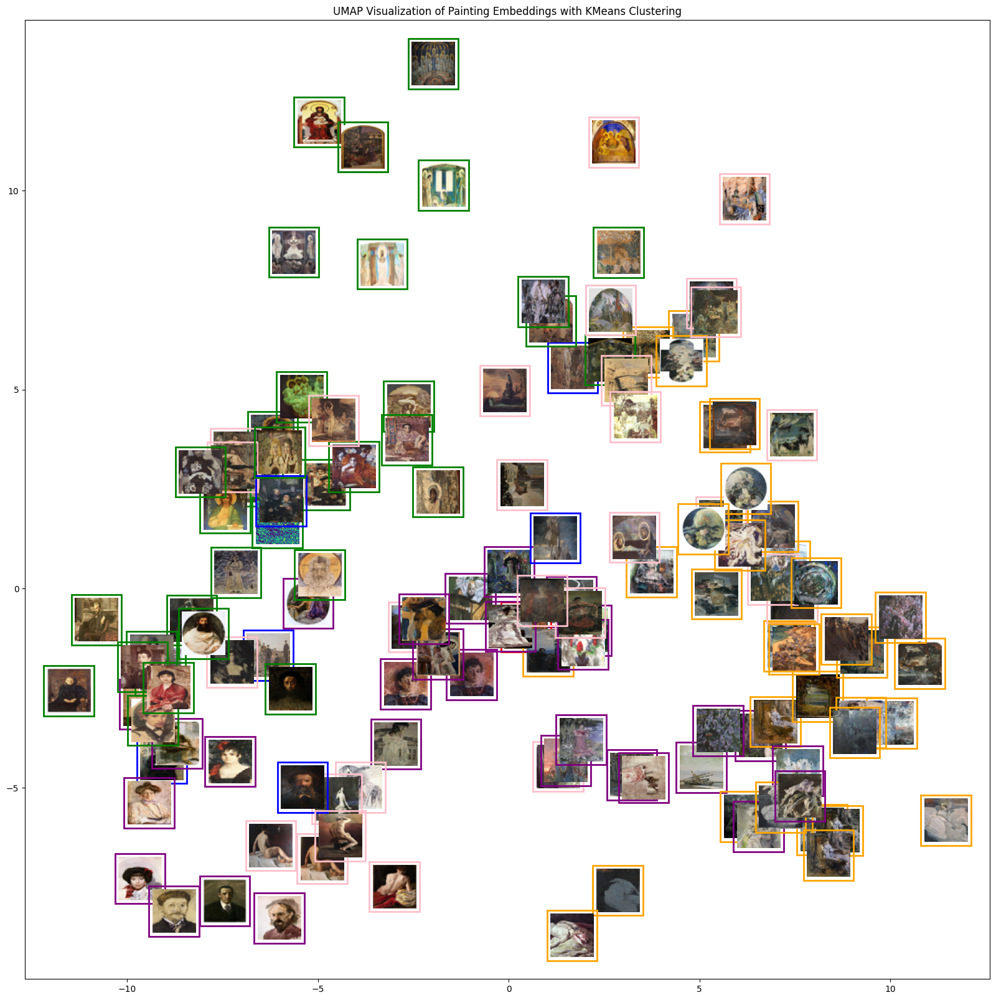

In [39]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange',  # Cluster 4
    'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(reduced_vectors):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[labels_kmeans[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Mean Shift

In [41]:
X_scaled = StandardScaler().fit_transform(vectors)

ms = MeanShift(bin_seeding=True)
labels_ms = ms.fit_predict(X_scaled)

In [42]:
unique_labels = np.unique(labels_ms)
n_clusters = len(unique_labels)
print(f"Найдено кластеров: {n_clusters}")

Найдено кластеров: 1


/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


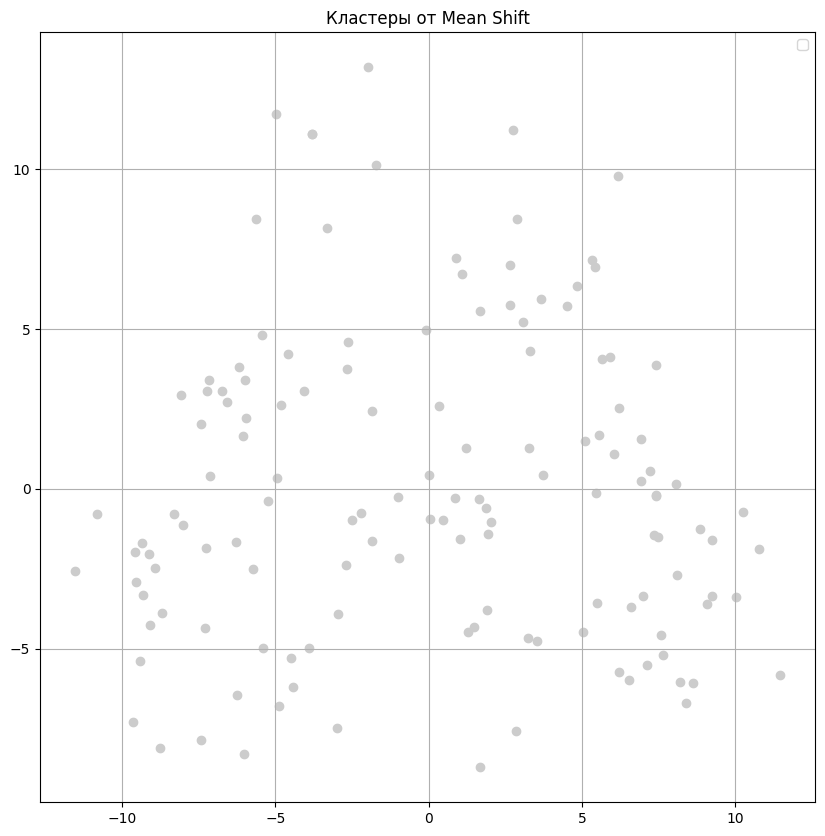

In [43]:
cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
colors = cmap(np.arange(n_clusters))

plt.figure(figsize=(10, 10))
for idx, label in enumerate(unique_labels):
    mask = labels_ms == label
    plt.scatter(reduced_vectors[mask, 0], reduced_vectors[mask, 1], 
                color=colors[idx]) #, label=f'Кластер {label}', s=50)

plt.title("Кластеры от Mean Shift")

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.legend()
plt.grid(True)
plt.show()

#### Spectral Clustering

In [44]:
spectral = SpectralClustering(
                            n_clusters=4, 
                            affinity='nearest_neighbors', 
                            assign_labels='kmeans', 
                            random_state=42
                            )
clusters = spectral.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

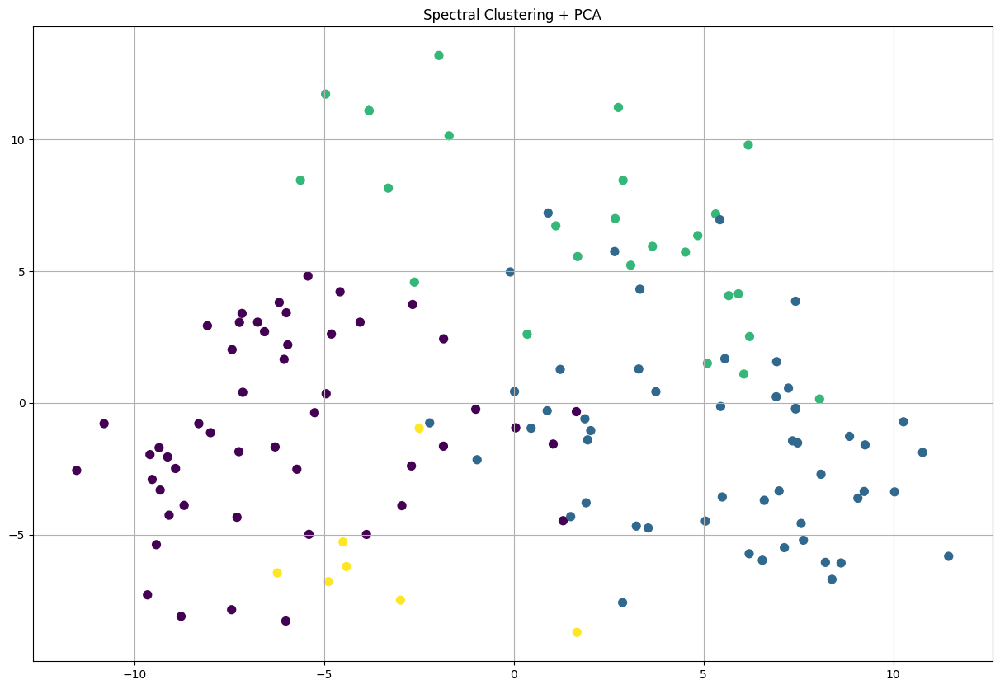

In [45]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Spectral Clustering + PCA')
plt.grid(True)
plt.show()

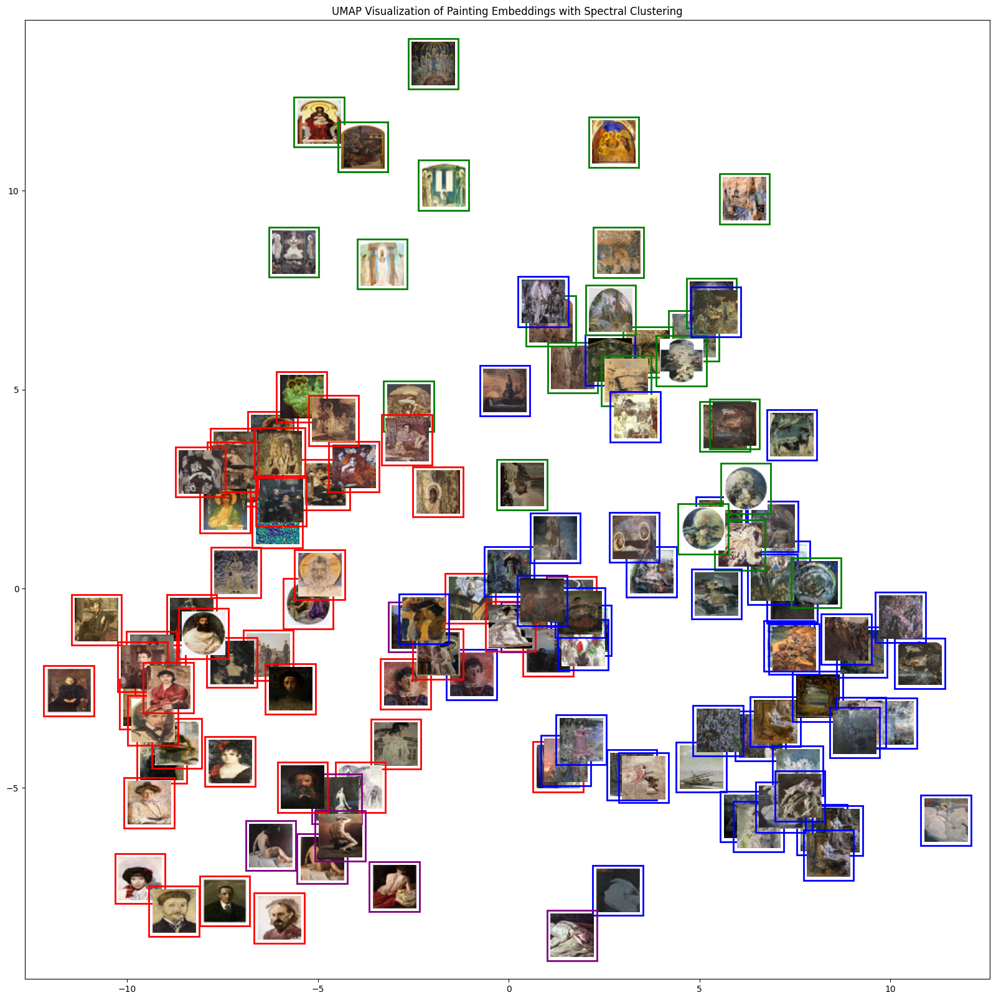

In [46]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Spectral Clustering")
plt.show()

#### GaussianMixture

In [47]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

gmm = GaussianMixture(n_components=2, random_state=0)
gmm.fit(X_reduced)
clusters_gmm = gmm.predict(X_reduced)

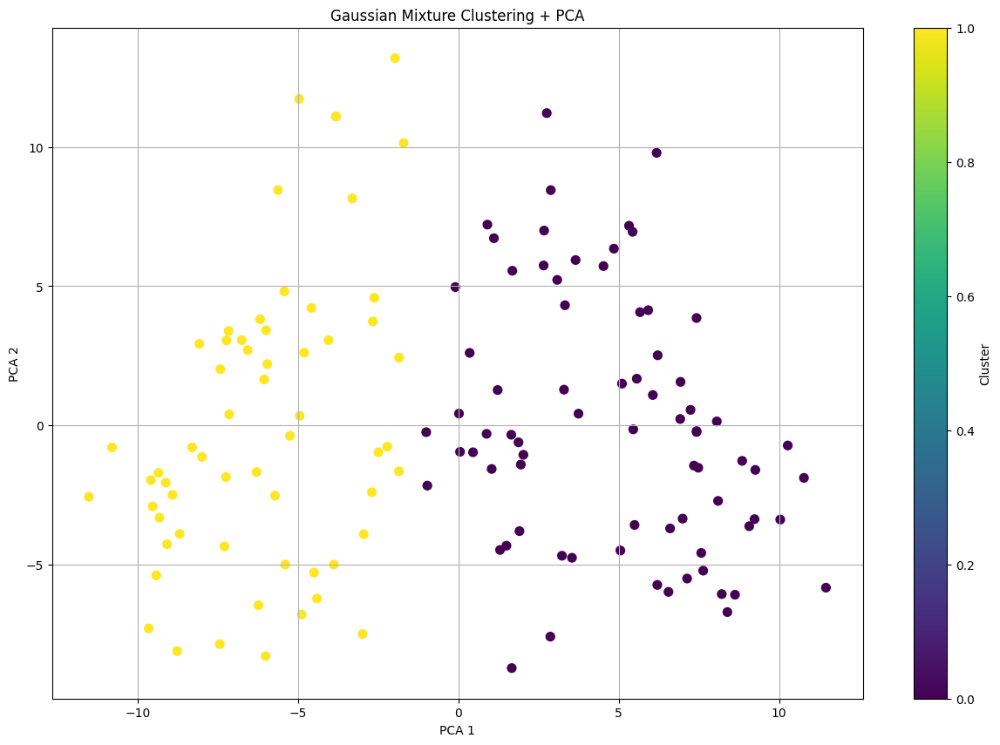

In [48]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_gmm, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Gaussian Mixture Clustering + PCA')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

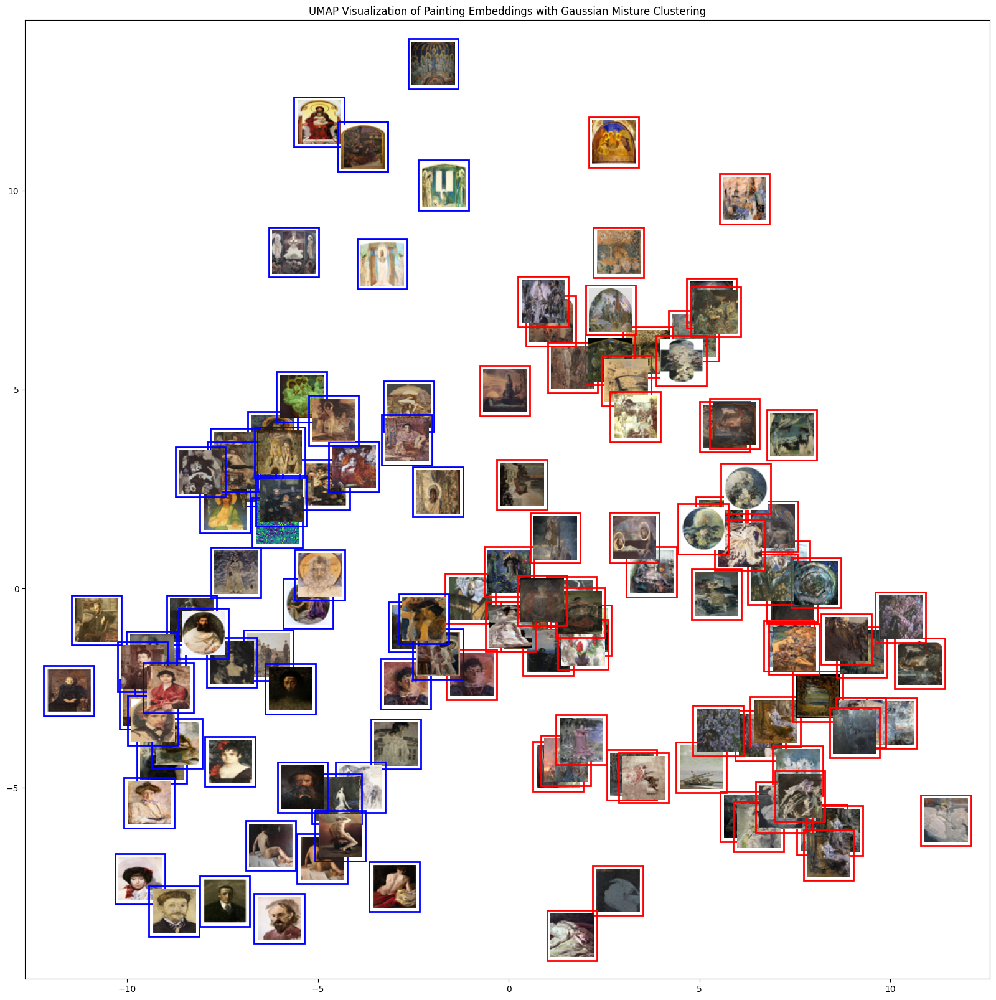

In [49]:
cluster_colors = [
    'red',    # Cluster 0
    'blue'   # Cluster 1
    # 'green',  # Cluster 2
    # 'purple', # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_gmm[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Gaussian Misture Clustering")
plt.show()

#### Birch

In [50]:
birch = Birch(n_clusters=4)
clusters_birch = birch.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

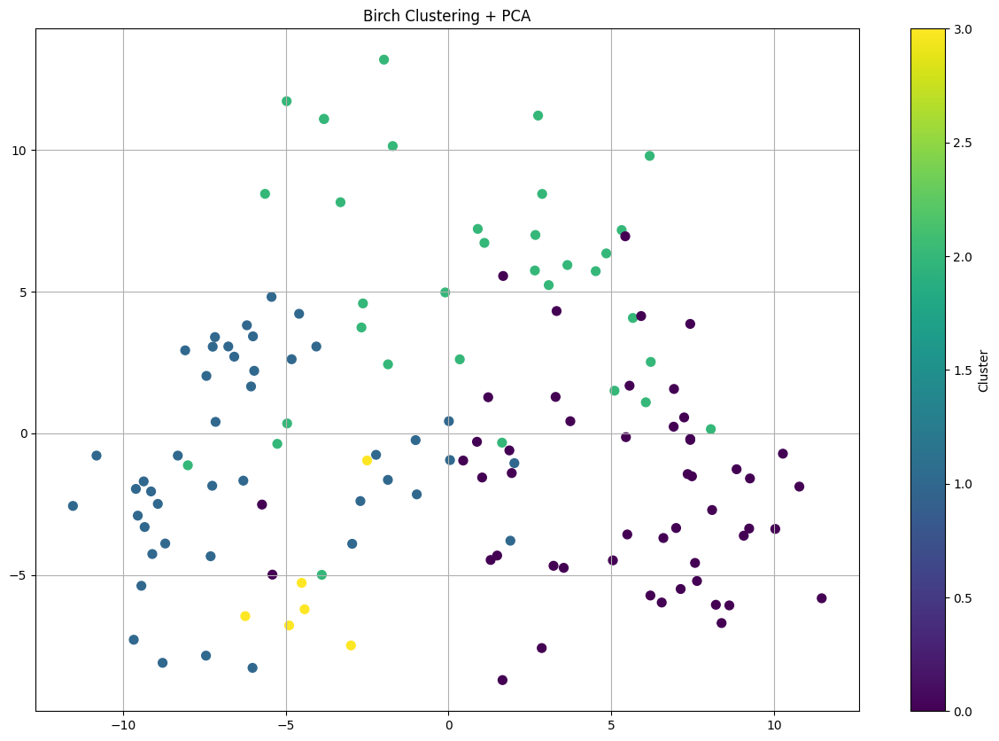

In [51]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_birch, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Birch Clustering + PCA')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

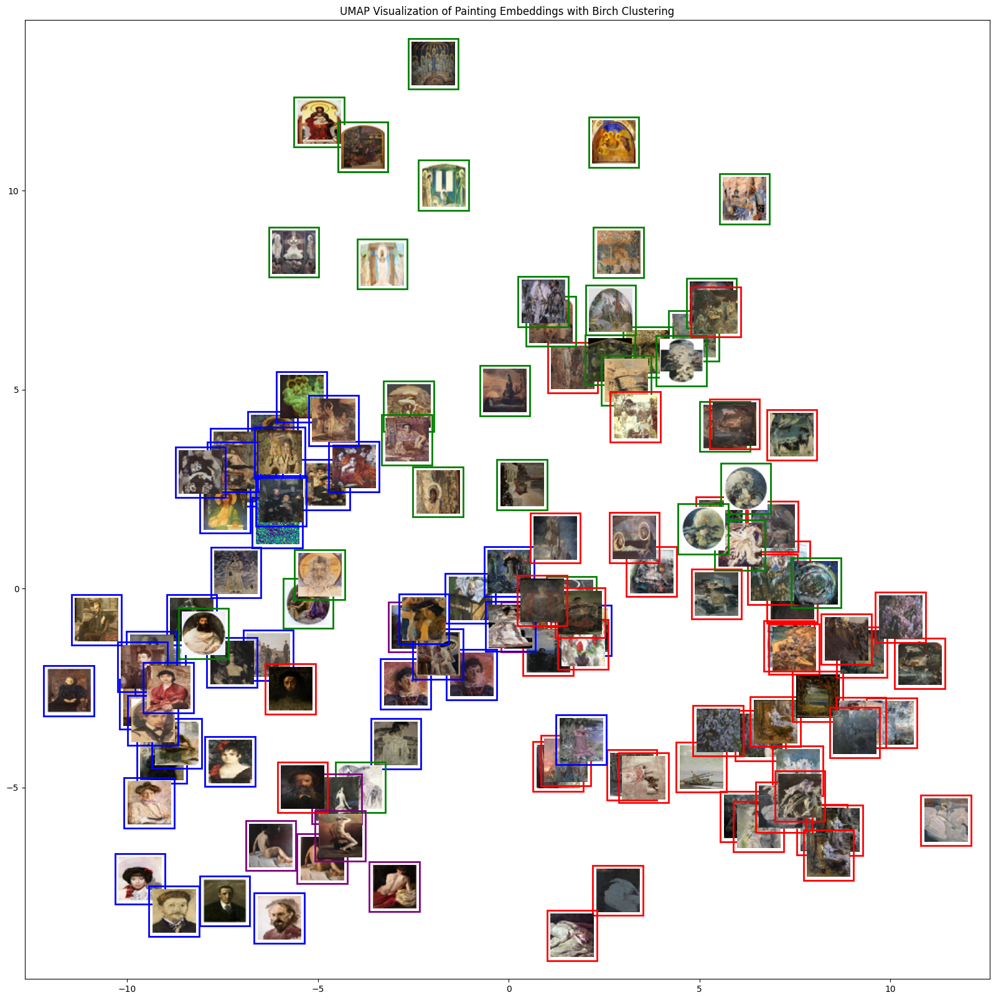

In [52]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_birch[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Birch Clustering")
plt.show()

#### Кластеризация с Umap

In [53]:
filenames = list(vecs_vit.keys())
# vecs = np.array([vecs_vit[fname][0] for fname in filenames]).astype(np.float32)
vecs = np.array([vecs_vit[filename] for filename in vecs_vit])

pca = PCA(n_components=3)
vecs = pca.fit_transform(vecs)

vector_lengths = [vecs[i].shape[0] for i in range(len(vecs))]

In [54]:
reducer = umap.UMAP(
            n_neighbors=2,
            n_components=2, #25, 17
            metric='cosine', 
            min_dist=0.55,
            spread=0.57, #1.7, #0.57,
            random_state=42
            )

embeddings_2d = reducer.fit_transform(vecs)

kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(embeddings_2d)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


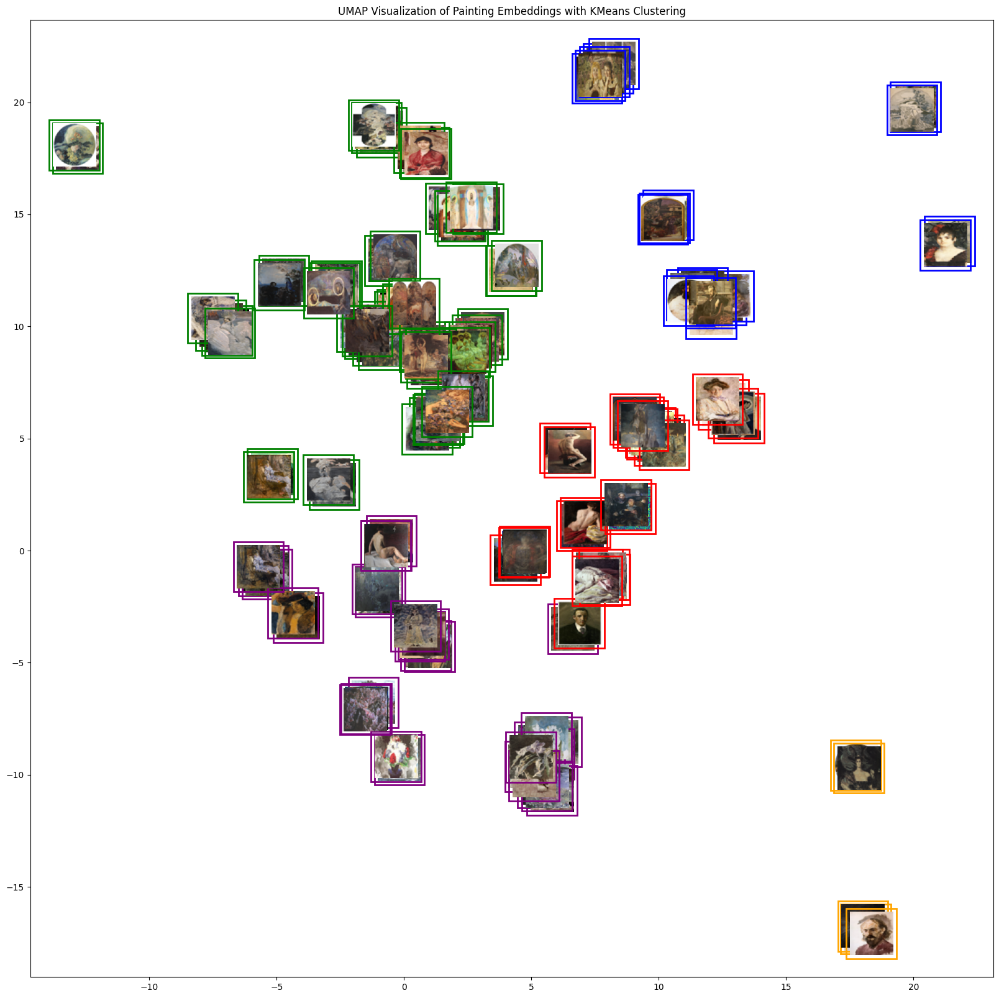

In [55]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange'  # Cluster 4
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(embeddings_2d):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[cluster_labels[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Теги и вектора siglip

In [193]:
all_dict = {}

for i in vecs_vit:
    try:
        all_dict[i] = {'vec': vecs_vit[i],
                    'tags': data_dict[i]
        }
    except:
        continue
    
len(all_dict)

210

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


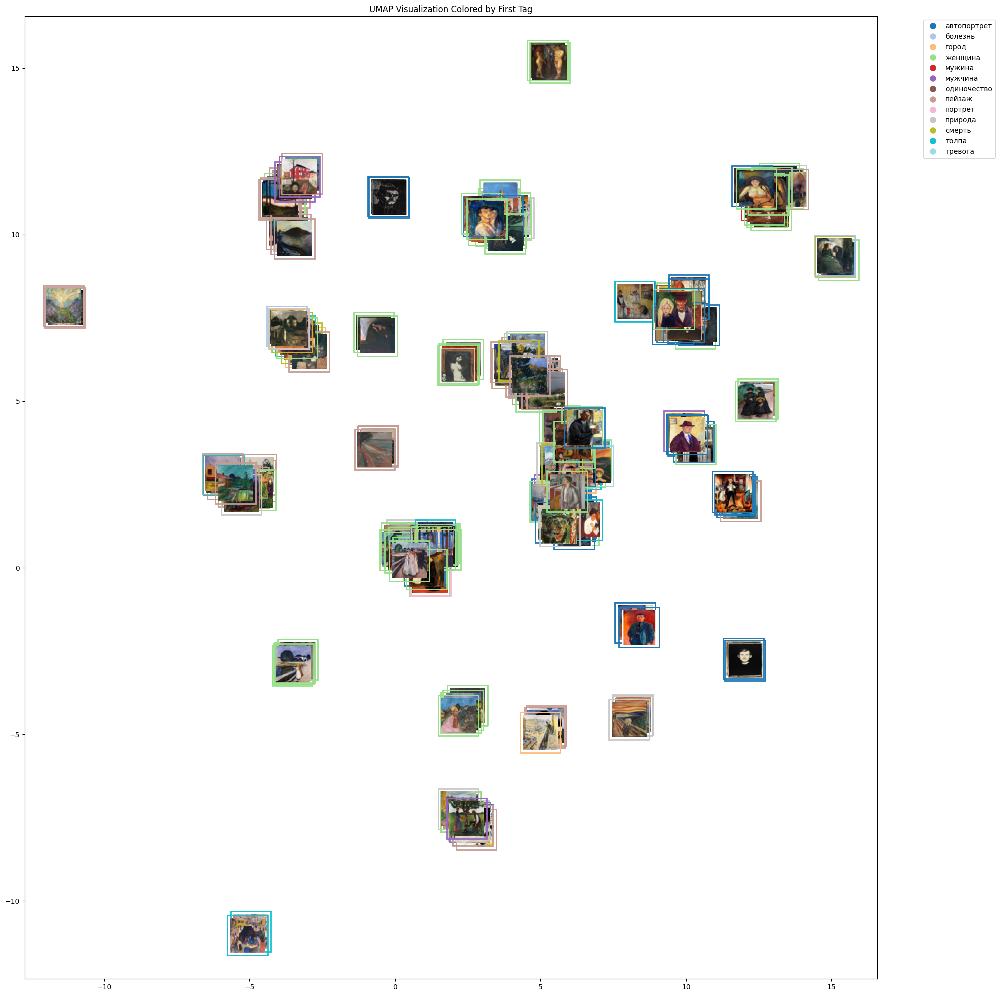

In [196]:
vecs = []
filenames = []

for fname, data in all_dict.items():
    vec = np.array(data['vec'])
    if vec.ndim > 1:
        vec = vec[0]  # взять первую строку, если это массив
    vecs.append(vec)
    filenames.append(fname)

vector_lengths = [v.shape[0] for v in vecs]
if len(set(vector_lengths)) > 1:
    max_len = max(vector_lengths)
    vecs_padded = np.zeros((len(vecs), max_len), dtype=np.float32)
    for i, v in enumerate(vecs):
        vecs_padded[i, :v.shape[0]] = v
    vecs = vecs_padded
else:
    vecs = np.vstack(vecs)

reducer = umap.UMAP(
    n_neighbors=2,
    n_components=2,
    metric='cosine',
    min_dist=0.35,
    spread=0.35,
    random_state=42
)
embeddings_2d = reducer.fit_transform(vecs)

all_tags = set()
for fname in filenames:
    tags = all_dict[fname]['tags']
    if tags:
        first_tag = tags[0] if isinstance(tags, (list, tuple)) else tags
        all_tags.add(first_tag)

unique_tags = sorted(list(all_tags))
tag_colors = plt.cm.tab20(np.linspace(0, 1, len(unique_tags)))
tag_to_color = {tag: color for tag, color in zip(unique_tags, tag_colors)}

plt.figure(figsize=(20, 20))
ax = plt.gca()

for i, (x, y) in enumerate(embeddings_2d):
    fname = filenames[i]
    path = os.path.join(path_munch_pics, fname)
    
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        tags = all_dict[fname]['tags']
        first_tag = tags[0] if isinstance(tags, (list, tuple)) and tags else tags
        color = tag_to_color.get(first_tag, 'gray')

        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(
                edgecolor=color,
                linewidth=2,
                facecolor='none'
            )
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

legend_handles = [
    plt.Line2D([0], [0], marker='o', color='w', 
               markerfacecolor=color, markersize=10, label=tag)
    for tag, color in tag_to_color.items()
]
plt.legend(handles=legend_handles, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)
plt.title("UMAP Visualization Colored by First Tag")
plt.tight_layout()
plt.show()

## Векторы CLIP

In [56]:
# filenames = list(i.split('_')[0] for i in vecs_vit)
filenames = list(i for i in vecs_clip)
vectors = np.array([np.array(v).flatten() for v in vecs_clip.values()])

In [57]:
colors = []
for filename in vecs_clip.keys():
    if filename.split('_')[0] == 'yyyy': # blue - before treatment
        colors.append('blue')
    elif int(filename.split('_')[0]) < 1908:
        colors.append('blue')
    else:
        colors.append('red') # red - after treatment

#### KMeans

In [58]:
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
labels_kmeans = kmeans.fit_predict(vectors)

pca = PCA(n_components=2)
reduced_vectors = pca.fit_transform(vectors)

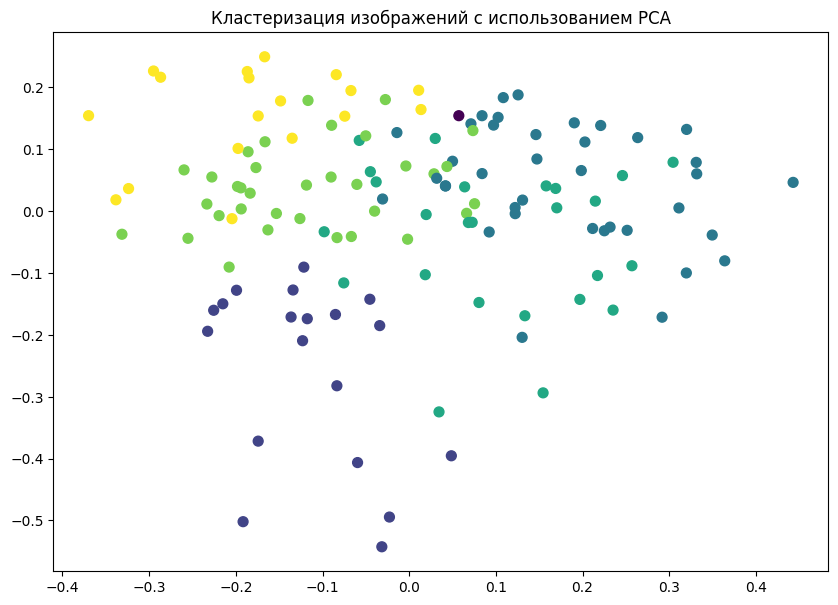

In [59]:
plt.figure(figsize=(10, 7))
scatter = plt.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], c=labels_kmeans, cmap='viridis', s=50)

# for i, label in enumerate(filenames):
#     x, y = reduced_vectors[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.title('Кластеризация изображений с использованием PCA')
plt.show()

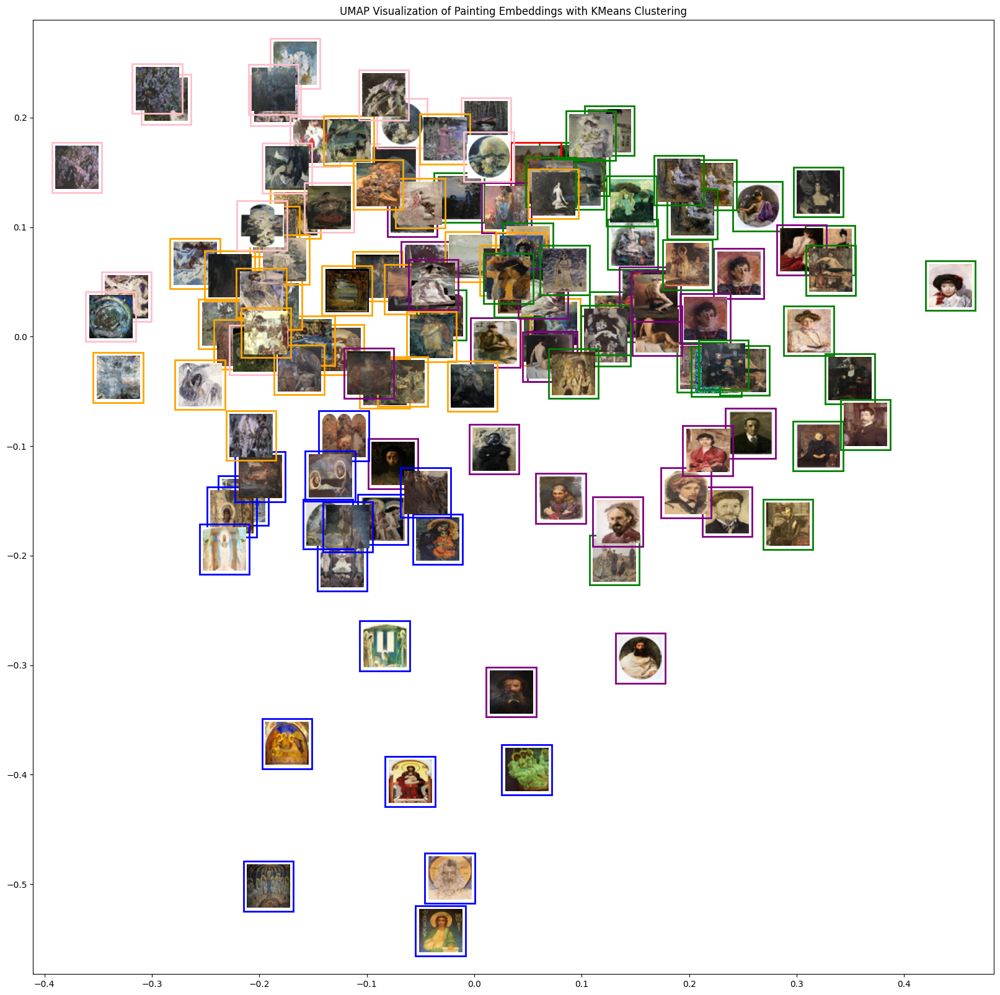

In [60]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange',  # Cluster 4
    'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(reduced_vectors):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[labels_kmeans[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Mean Shift

In [62]:
X_scaled = StandardScaler().fit_transform(vectors)

ms = MeanShift(bin_seeding=True)
labels_ms = ms.fit_predict(X_scaled)

In [63]:
unique_labels = np.unique(labels_ms)
n_clusters = len(unique_labels)
print(f"Найдено кластеров: {n_clusters}")

Найдено кластеров: 1


/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


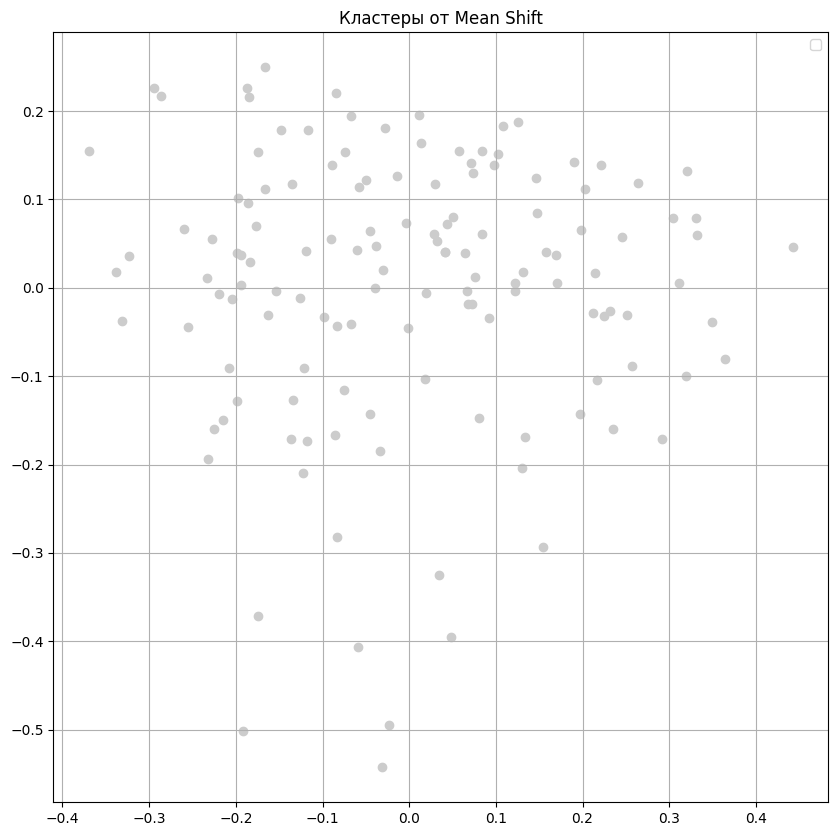

In [64]:
cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
colors = cmap(np.arange(n_clusters))

plt.figure(figsize=(10, 10))
for idx, label in enumerate(unique_labels):
    mask = labels_ms == label
    plt.scatter(reduced_vectors[mask, 0], reduced_vectors[mask, 1], 
                color=colors[idx]) #, label=f'Кластер {label}', s=50)

plt.title("Кластеры от Mean Shift")

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.legend()
plt.grid(True)
plt.show()

#### Spectral Clustering

In [65]:
spectral = SpectralClustering(
                            n_clusters=4, 
                            affinity='nearest_neighbors', 
                            assign_labels='kmeans', 
                            random_state=42
                            )
clusters = spectral.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

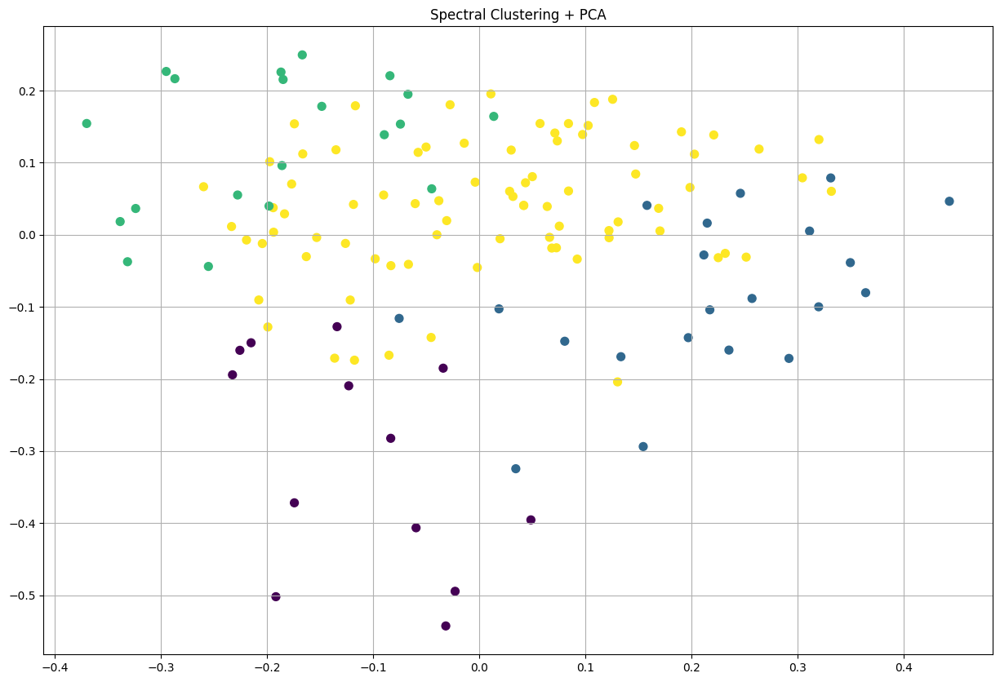

In [66]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Spectral Clustering + PCA')
plt.grid(True)
plt.show()

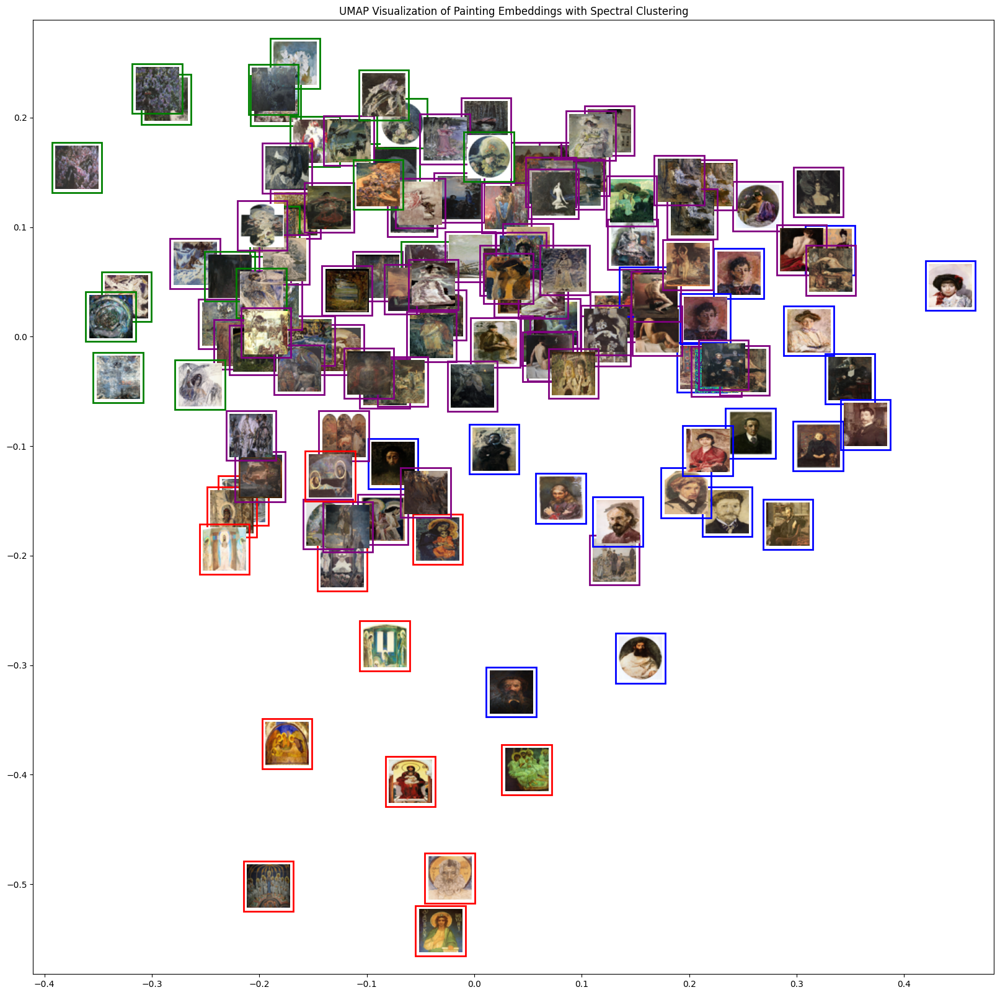

In [67]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Spectral Clustering")
plt.show()

#### Gaussian Mixture

In [68]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

gmm = GaussianMixture(n_components=2, random_state=0)
gmm.fit(X_reduced)
clusters_gmm = gmm.predict(X_reduced)

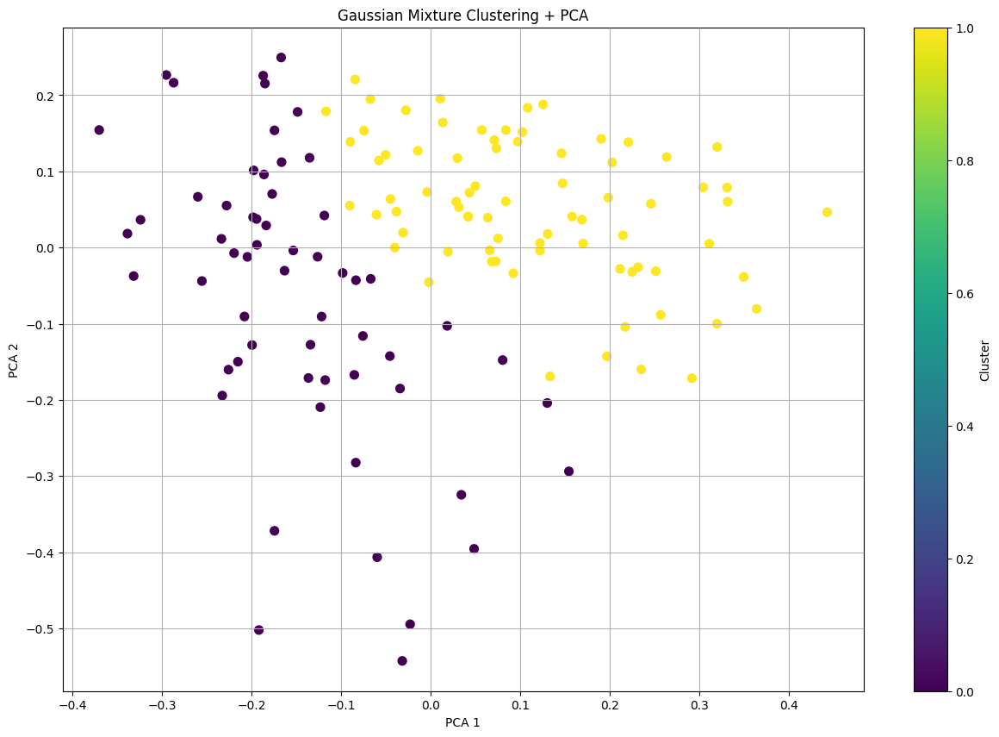

In [69]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_gmm, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Gaussian Mixture Clustering + PCA')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

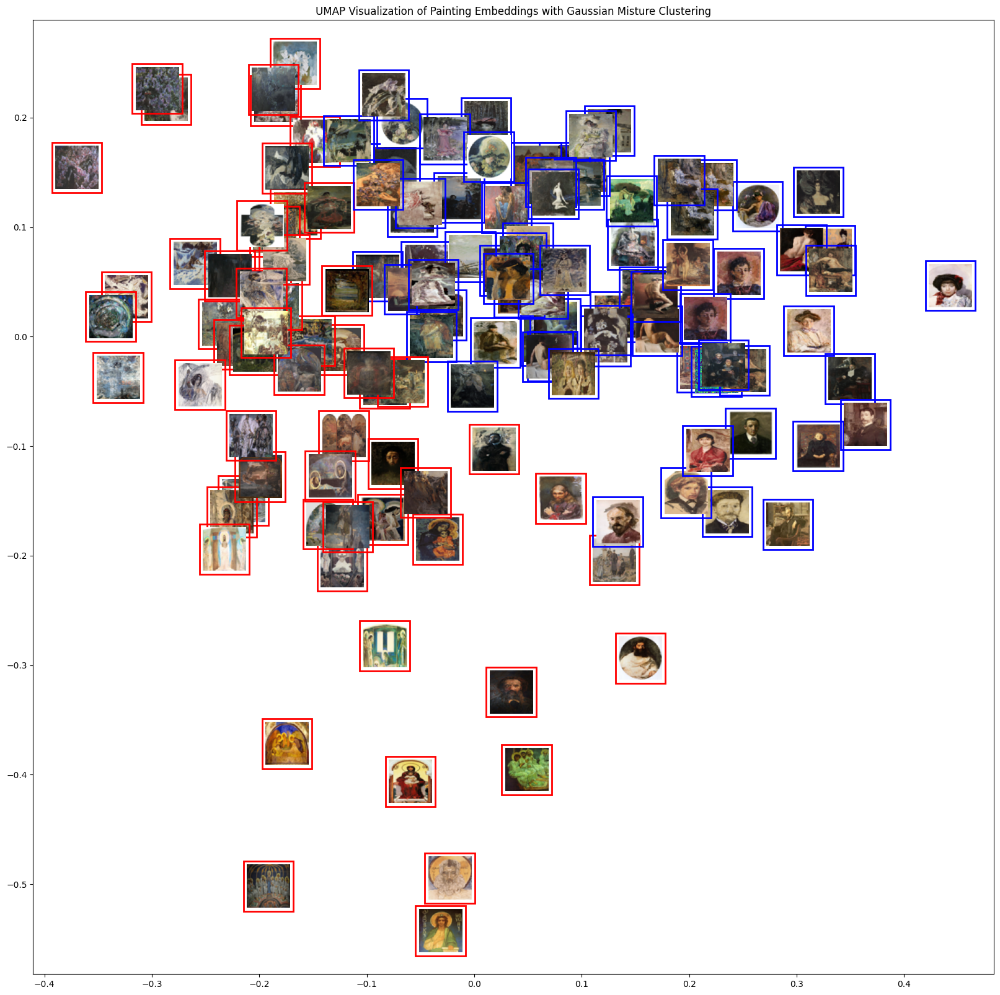

In [70]:
cluster_colors = [
    'red',    # Cluster 0
    'blue'   # Cluster 1
    # 'green',  # Cluster 2
    # 'purple', # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_gmm[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Gaussian Misture Clustering")
plt.show()

#### Birch

In [71]:
birch = Birch(n_clusters=4)
clusters_birch = birch.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

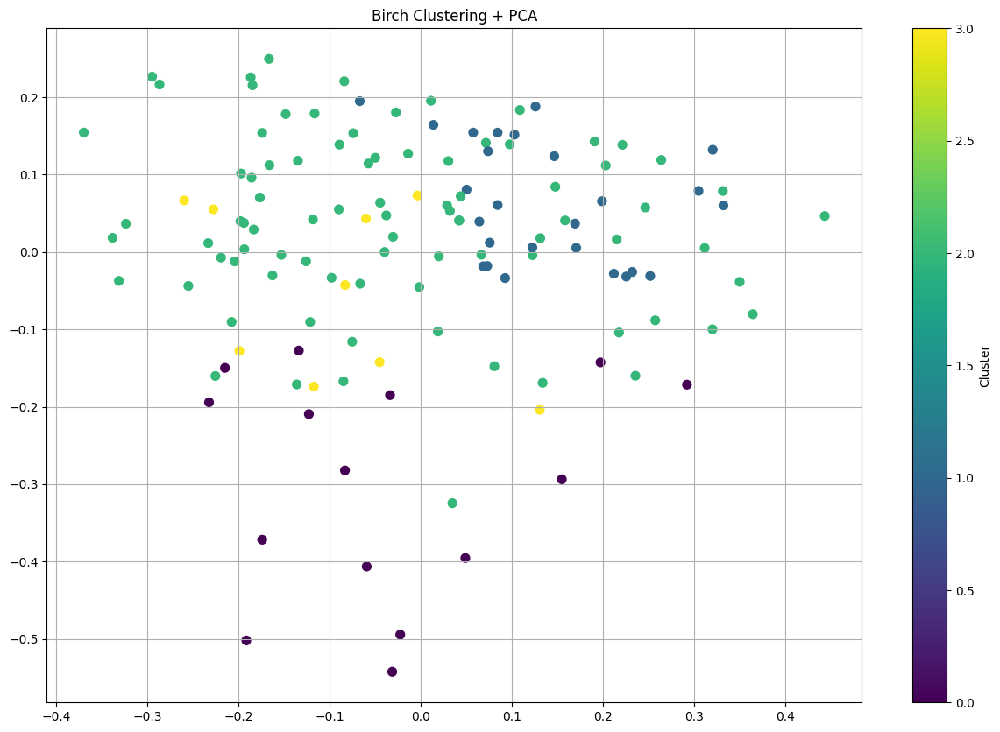

In [72]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_birch, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Birch Clustering + PCA')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

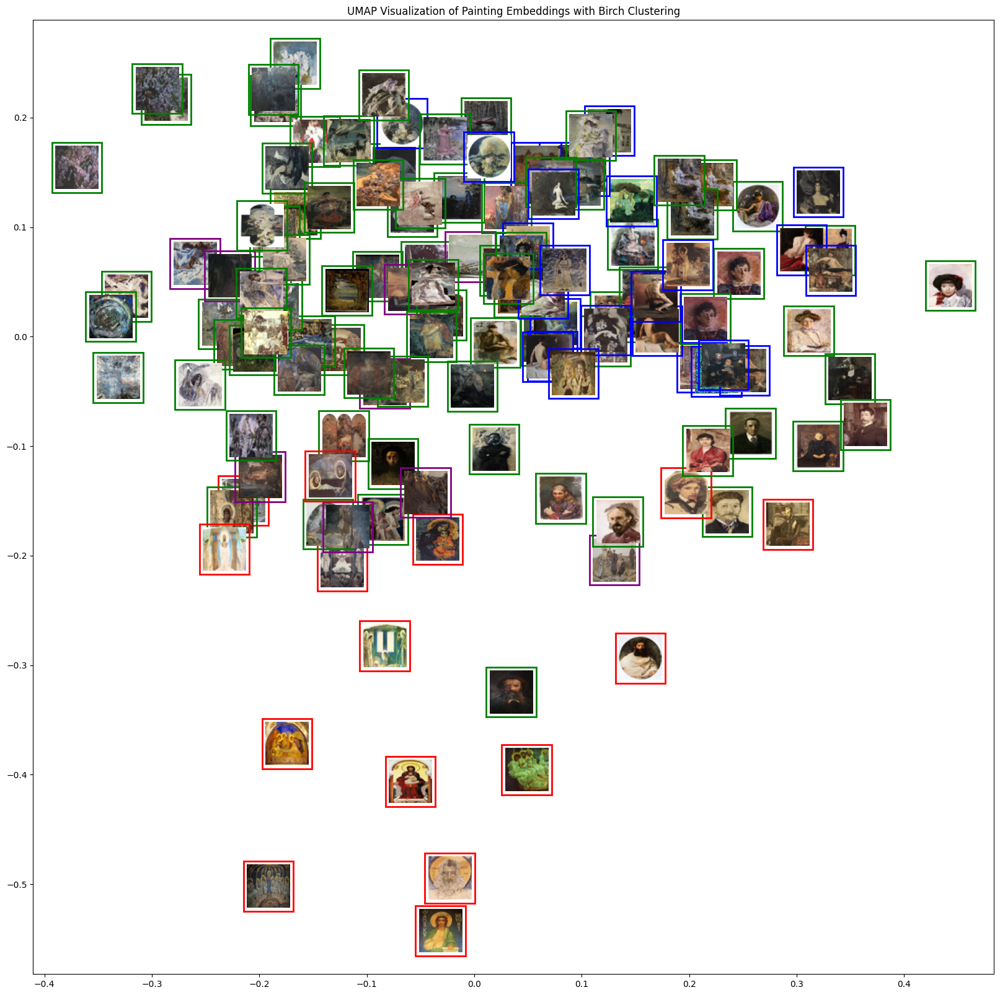

In [73]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_birch[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Birch Clustering")
plt.show()

#### Кластеризация с Umap

In [74]:
# filenames = list(vecs_clip.keys())
# vecs = np.array([vecs_clip[fname][0] for fname in filenames])
# vecs = vecs.reshape(1, -1)

vecs = np.array([vecs_clip[filename] for filename in vecs_clip])
filenames = list(vecs_clip.keys())

In [75]:
pca = PCA(n_components=3)
vecs = pca.fit_transform(vecs)

vector_lengths = [vecs[i].shape[0] for i in range(len(vecs))]

In [76]:
reducer = umap.UMAP(
            n_neighbors=2,
            n_components=2, #25, 17
            metric='cosine', 
            min_dist=0.55,
            spread=0.57, #1.7, #0.57,
            random_state=42
            )

embeddings_2d = reducer.fit_transform(vecs)

kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(embeddings_2d)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


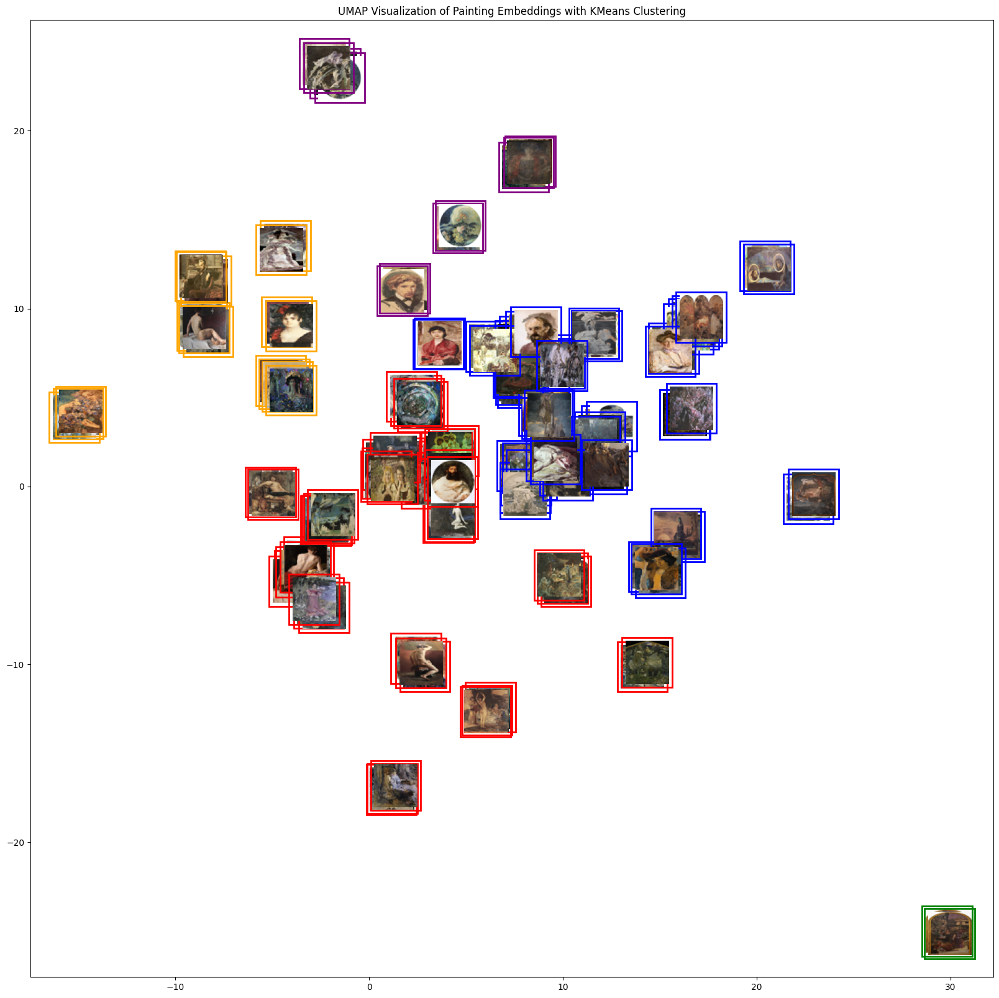

In [77]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange'  # Cluster 4
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(embeddings_2d):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[cluster_labels[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Теги и вектора clip

In [88]:
# data_dict = {}

# with open(tags_path, 'r', encoding='utf-8') as file:
#     for line in file:
#         line = line.strip()
#         if '—' in line:
#             key, value = line.split('—', 1)
#             key = key.strip()
#             value = value.strip()
#             data_dict[key] = value.split(' ')

# len(data_dict)

In [89]:
all_dict = {}

for i in vecs_clip:
    try:
        all_dict[i] = {'vec': vecs_clip[i],
                    'tags': data_dict[i]
        }
    except:
        continue
    
len(all_dict)

0

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


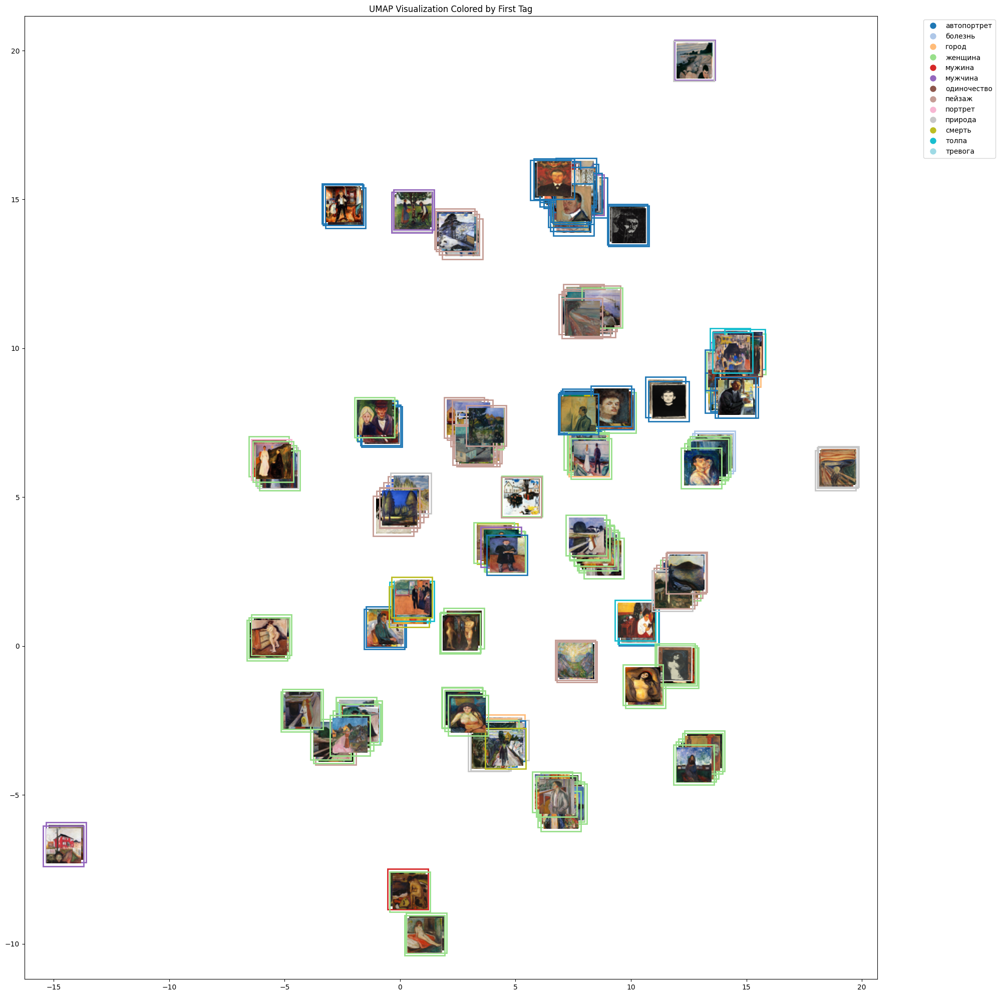

In [200]:
vecs = []
filenames = []

for fname, data in all_dict.items():
    vec = np.array(data['vec'])
    if vec.ndim > 1:
        vec = vec[0]  # взять первую строку, если это массив
    vecs.append(vec)
    filenames.append(fname)

vector_lengths = [v.shape[0] for v in vecs]
if len(set(vector_lengths)) > 1:
    max_len = max(vector_lengths)
    vecs_padded = np.zeros((len(vecs), max_len), dtype=np.float32)
    for i, v in enumerate(vecs):
        vecs_padded[i, :v.shape[0]] = v
    vecs = vecs_padded
else:
    vecs = np.vstack(vecs)

reducer = umap.UMAP(
    n_neighbors=2,
    n_components=2,
    metric='cosine',
    min_dist=0.35,
    spread=0.35,
    random_state=42
)
embeddings_2d = reducer.fit_transform(vecs)

all_tags = set()
for fname in filenames:
    tags = all_dict[fname]['tags']
    if tags:
        first_tag = tags[0] if isinstance(tags, (list, tuple)) else tags
        all_tags.add(first_tag)

unique_tags = sorted(list(all_tags))
tag_colors = plt.cm.tab20(np.linspace(0, 1, len(unique_tags)))
tag_to_color = {tag: color for tag, color in zip(unique_tags, tag_colors)}

plt.figure(figsize=(20, 20))
ax = plt.gca()

for i, (x, y) in enumerate(embeddings_2d):
    fname = filenames[i]
    path = os.path.join(path_munch_pics, fname)
    
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        tags = all_dict[fname]['tags']
        first_tag = tags[0] if isinstance(tags, (list, tuple)) and tags else tags
        color = tag_to_color.get(first_tag, 'gray')

        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(
                edgecolor=color,
                linewidth=2,
                facecolor='none'
            )
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

legend_handles = [
    plt.Line2D([0], [0], marker='o', color='w', 
               markerfacecolor=color, markersize=10, label=tag)
    for tag, color in tag_to_color.items()
]
plt.legend(handles=legend_handles, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)
plt.title("UMAP Visualization Colored by First Tag")
plt.tight_layout()
plt.show()

## Векторы resnet50

In [78]:
filenames = list(i for i in vecs_resnet50)
vectors = np.array([np.array(v).flatten() for v in vecs_resnet50.values()])

In [79]:
colors = []
for filename in vecs_resnet50.keys():
    if filename.split('_')[0] == 'yyyy': # blue - before treatment
        colors.append('blue')
    elif int(filename.split('_')[0]) < 1819:
        colors.append('blue')
    else:
        colors.append('red') # red - after treatment

#### KMeans

In [80]:
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
labels_kmeans = kmeans.fit_predict(vectors)

pca = PCA(n_components=2)
reduced_vectors = pca.fit_transform(vectors)

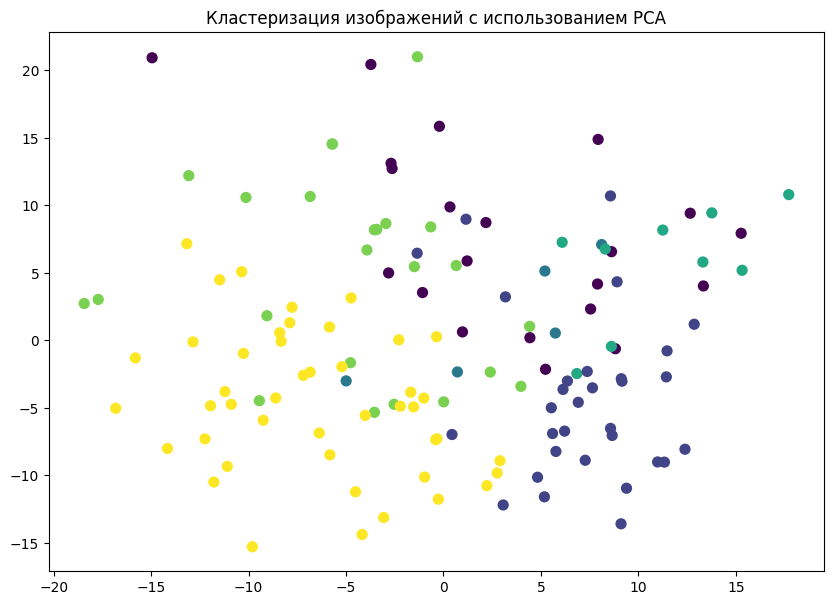

In [81]:
plt.figure(figsize=(10, 7))
scatter = plt.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], c=labels_kmeans, cmap='viridis', s=50)

# for i, label in enumerate(filenames):
#     x, y = reduced_vectors[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.title('Кластеризация изображений с использованием PCA')
plt.show()

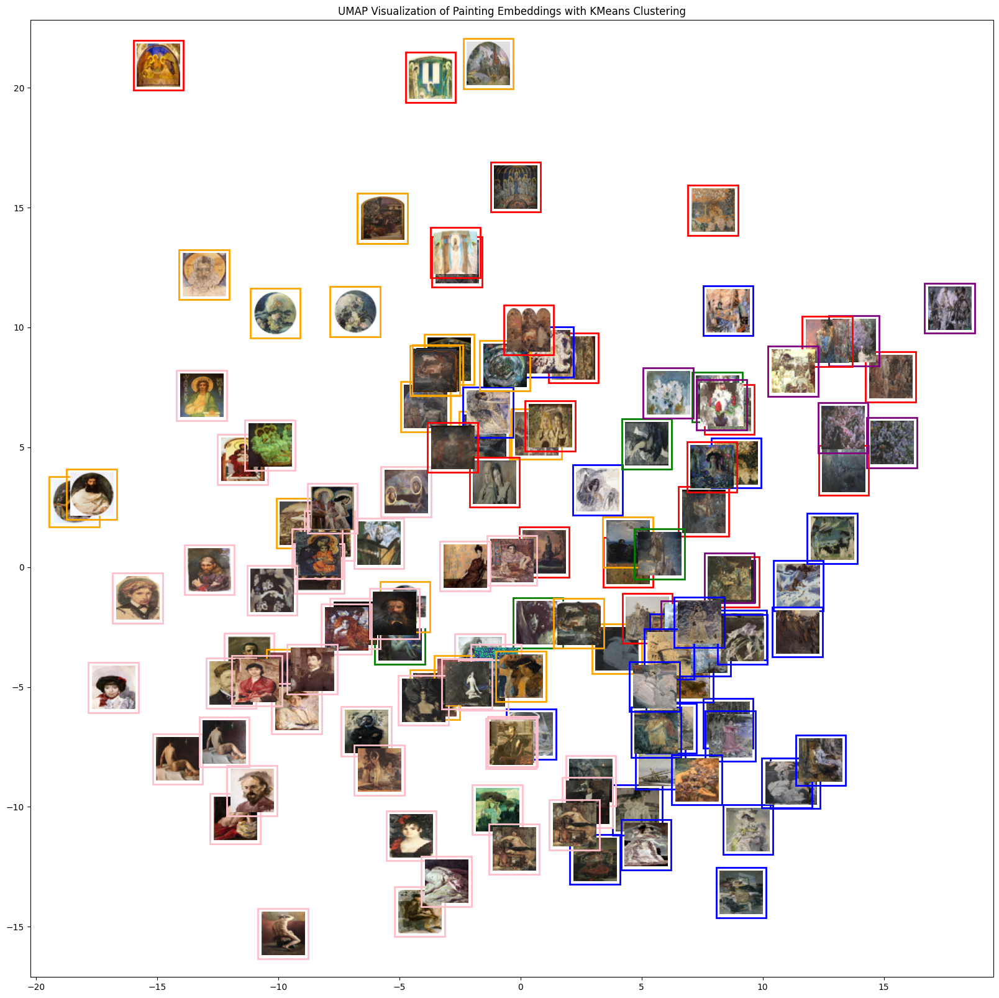

In [82]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange',  # Cluster 4
    'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(reduced_vectors):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[labels_kmeans[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Mean Shift

In [84]:
X_scaled = StandardScaler().fit_transform(vectors)

ms = MeanShift(bin_seeding=True)
labels_ms = ms.fit_predict(X_scaled)

In [85]:
unique_labels = np.unique(labels_ms)
n_clusters = len(unique_labels)
print(f"Найдено кластеров: {n_clusters}")

Найдено кластеров: 1


/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


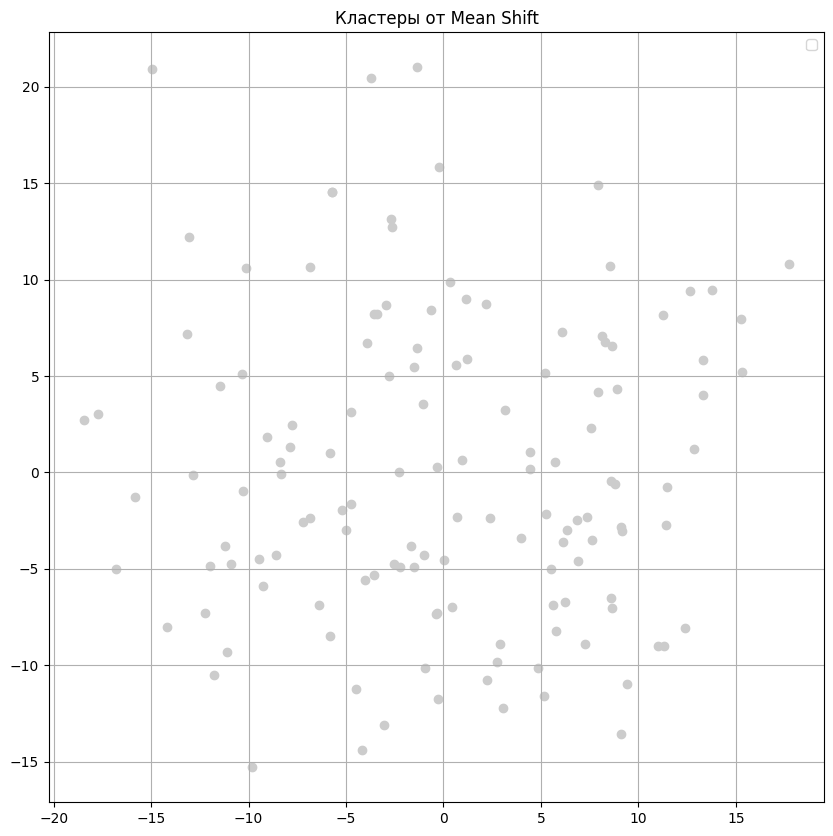

In [86]:
cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
colors = cmap(np.arange(n_clusters))

plt.figure(figsize=(10, 10))
for idx, label in enumerate(unique_labels):
    mask = labels_ms == label
    plt.scatter(reduced_vectors[mask, 0], reduced_vectors[mask, 1], 
                color=colors[idx]) #, label=f'Кластер {label}', s=50)

plt.title("Кластеры от Mean Shift")

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.legend()
plt.grid(True)
plt.show()

#### Spectral Clustering

In [87]:
spectral = SpectralClustering(
                            n_clusters=4, 
                            affinity='nearest_neighbors', 
                            assign_labels='kmeans', 
                            random_state=42
                            )
clusters = spectral.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

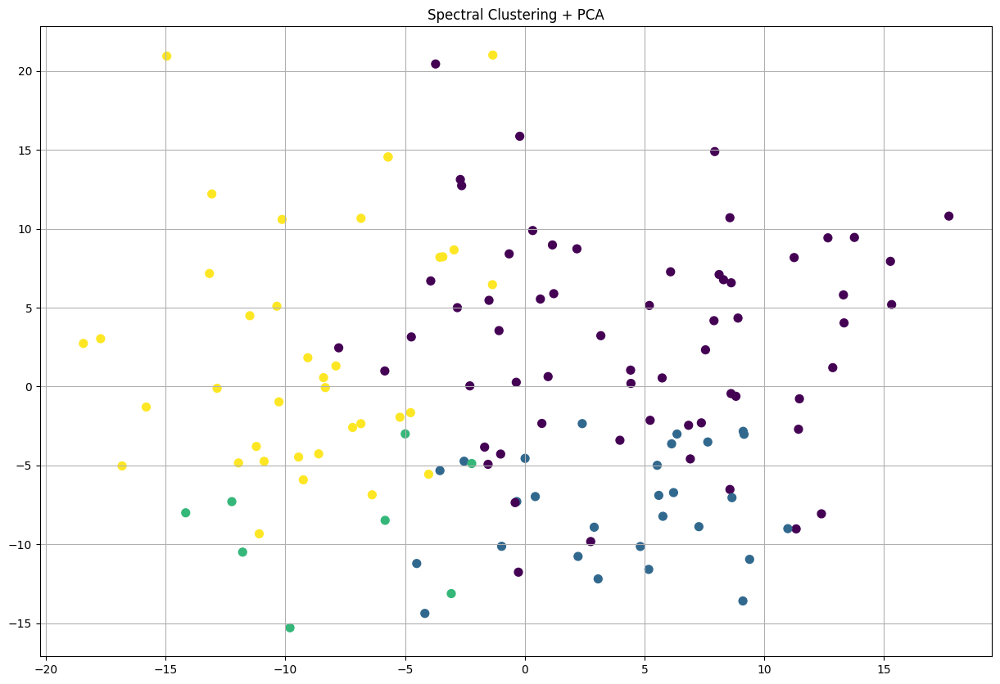

In [88]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Spectral Clustering + PCA')
plt.grid(True)
plt.show()

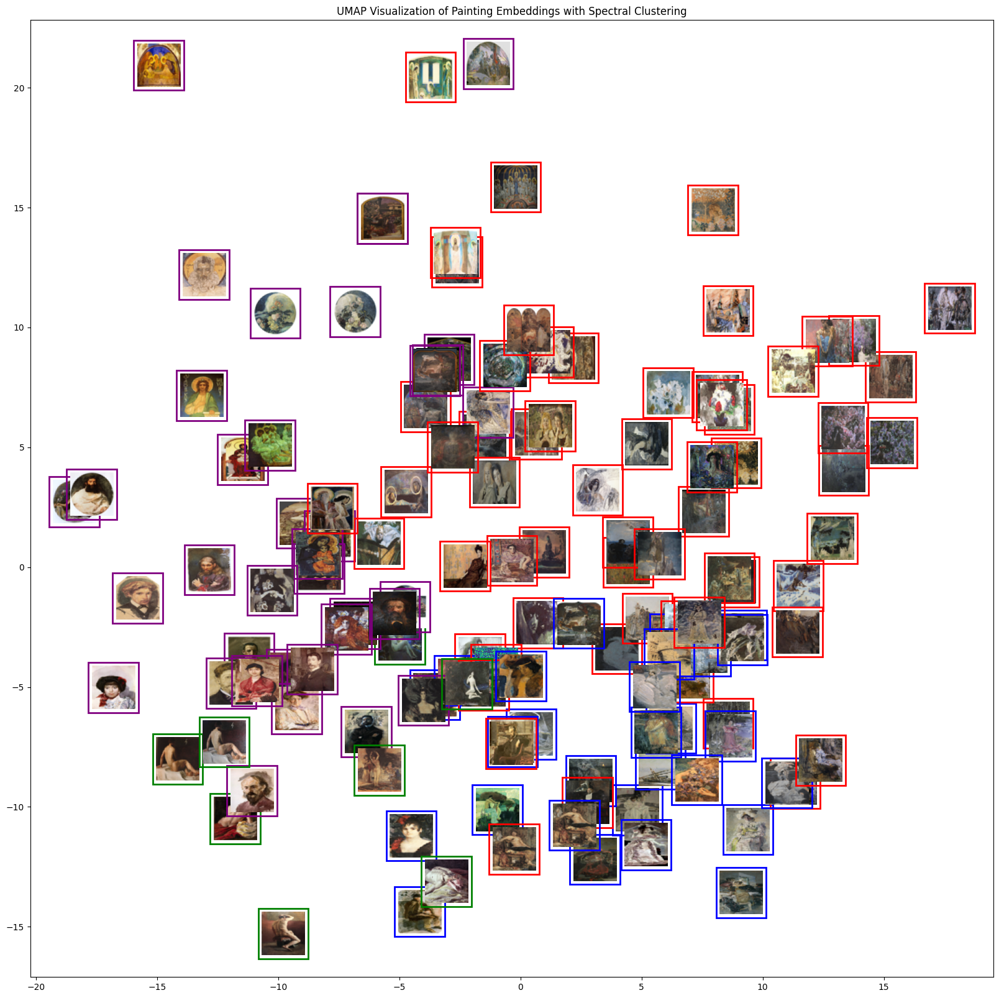

In [89]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Spectral Clustering")
plt.show()

#### GaussianMixture

In [90]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

gmm = GaussianMixture(n_components=2, random_state=0)
gmm.fit(X_reduced)
clusters_gmm = gmm.predict(X_reduced)

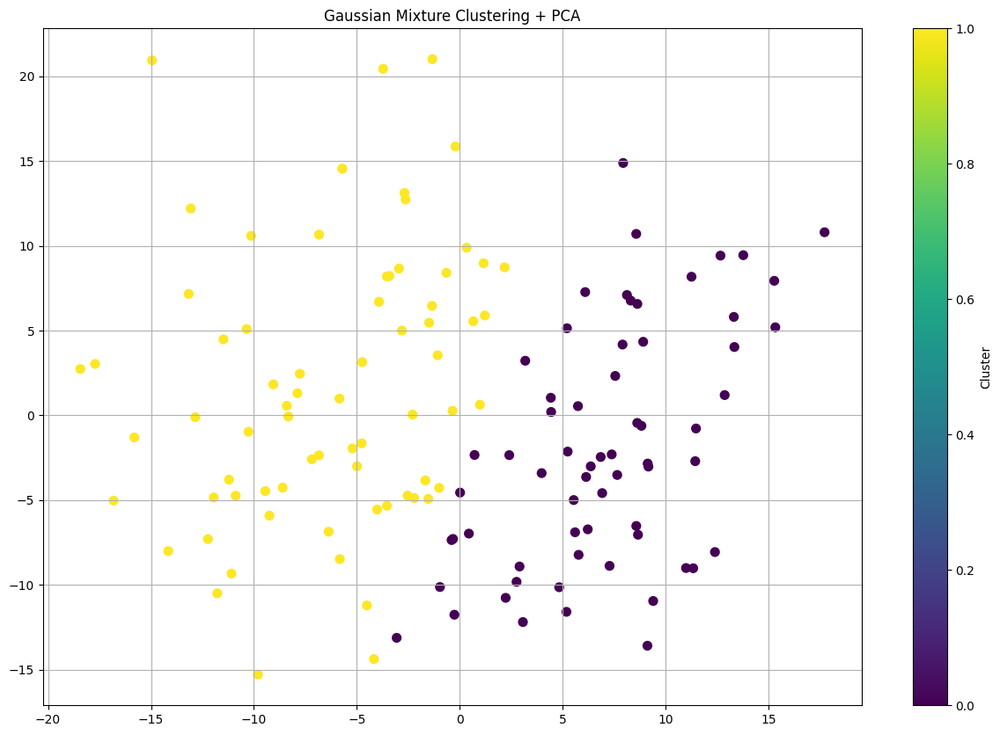

In [91]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_gmm, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Gaussian Mixture Clustering + PCA')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

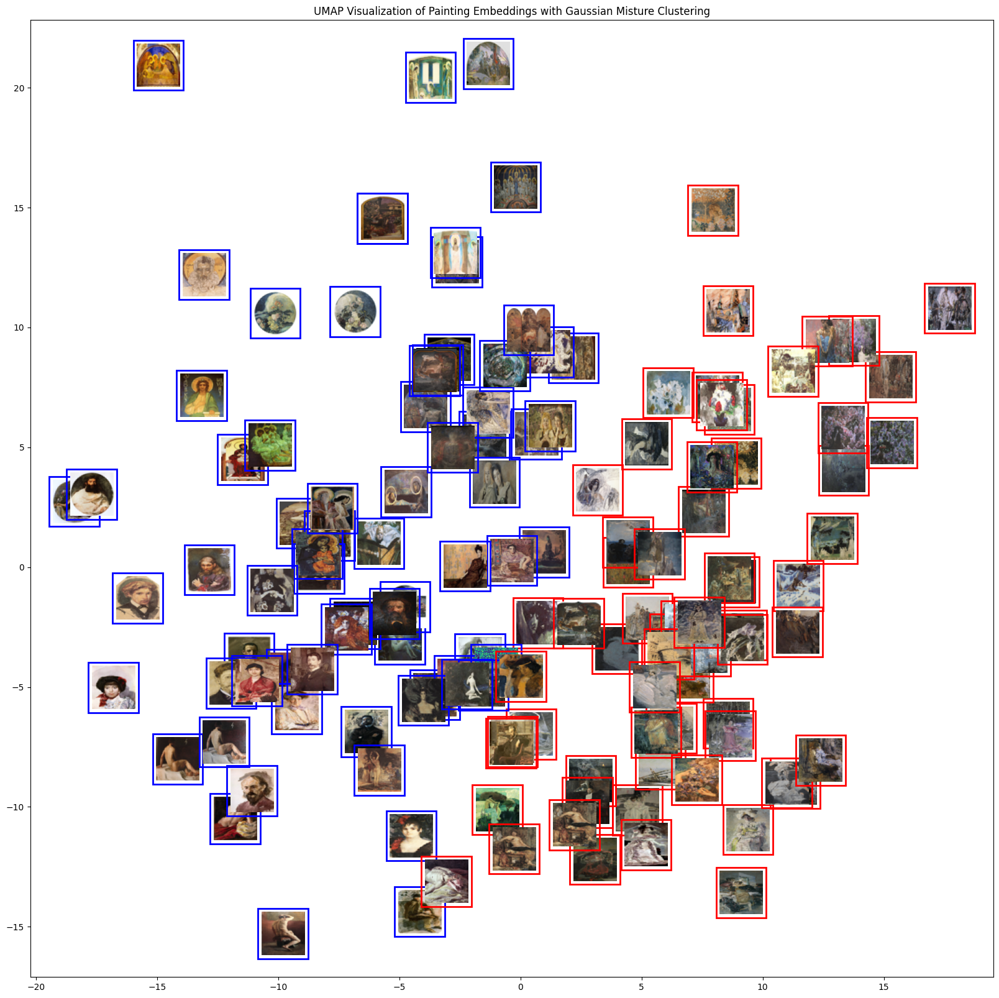

In [92]:
cluster_colors = [
    'red',    # Cluster 0
    'blue'   # Cluster 1
    # 'green',  # Cluster 2
    # 'purple', # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_gmm[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Gaussian Misture Clustering")
plt.show()

#### Birch

In [93]:
birch = Birch(n_clusters=4)
clusters_birch = birch.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

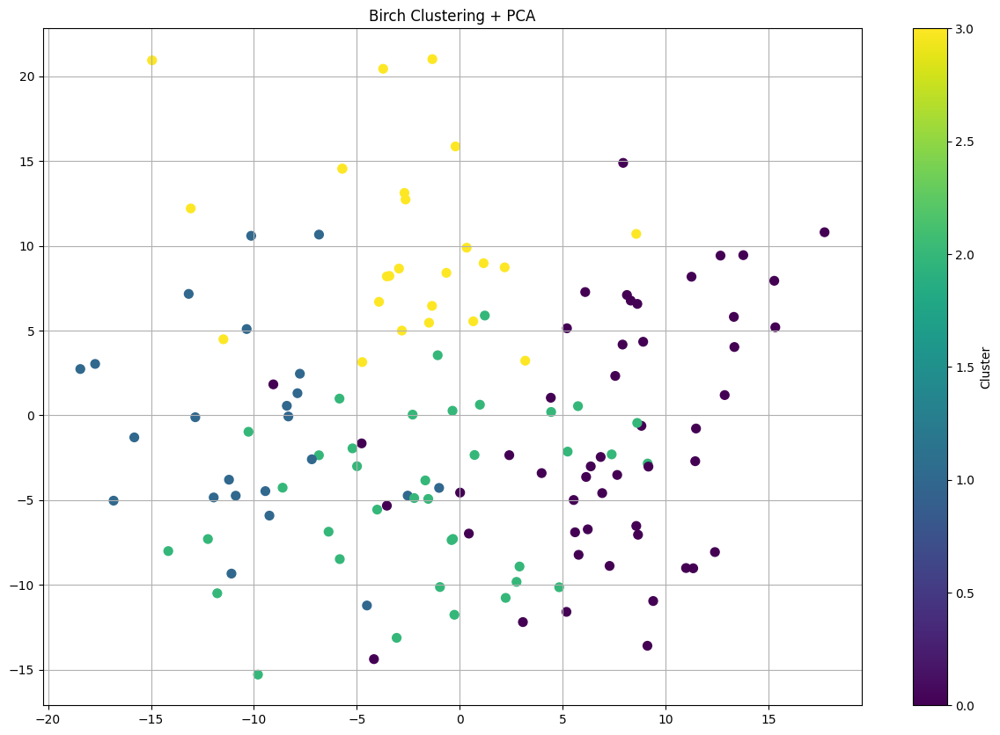

In [94]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_birch, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Birch Clustering + PCA')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

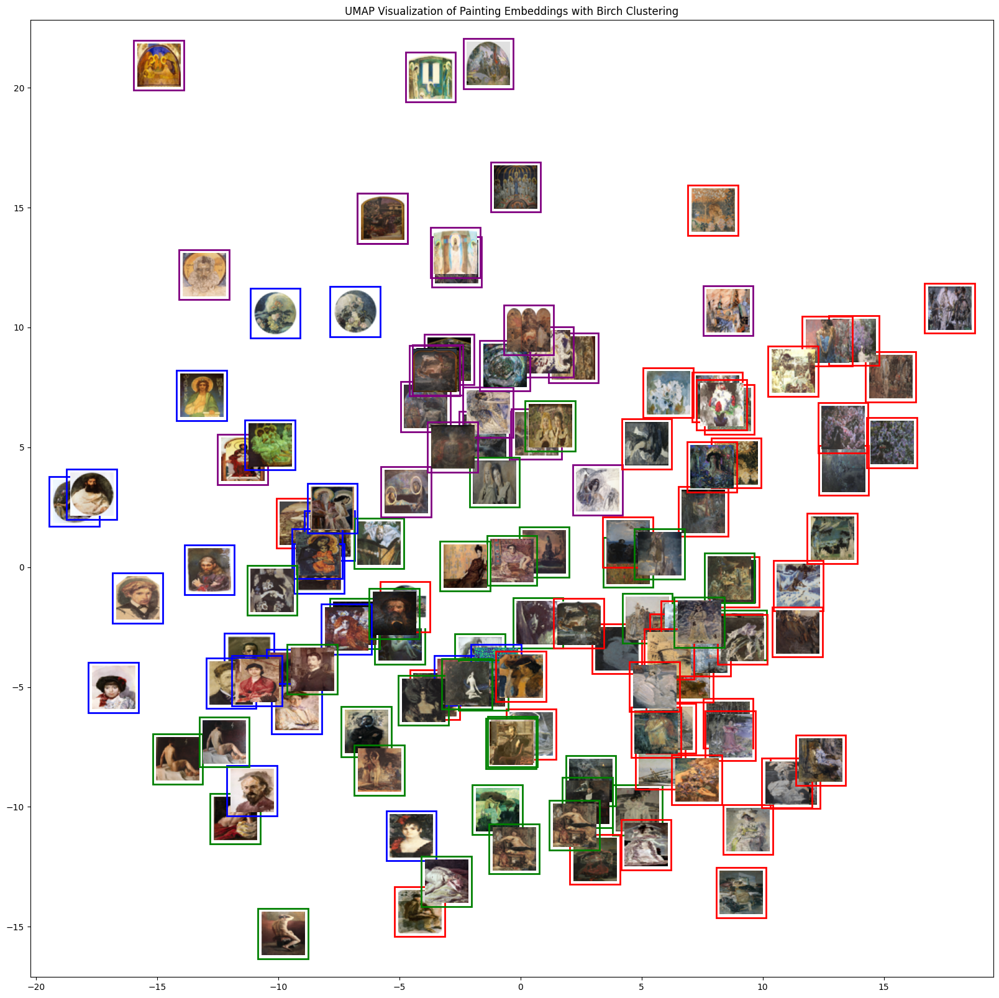

In [95]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_birch[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Birch Clustering")
plt.show()

#### Кластеризация с Umap

In [96]:
filenames = list(vecs_siglip.keys())
vecs = np.array([vecs_siglip[fname][0] for fname in filenames]).astype(np.float32)

pca = PCA(n_components=3)
vecs = pca.fit_transform(vecs)

vector_lengths = [vecs[i].shape[0] for i in range(len(vecs))]

In [97]:
reducer = umap.UMAP(
            n_neighbors=2,
            n_components=2, #25, 17
            metric='cosine', 
            min_dist=0.55,
            spread=0.57, #1.7, #0.57,
            random_state=42
            )

embeddings_2d = reducer.fit_transform(vecs)

kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(embeddings_2d)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


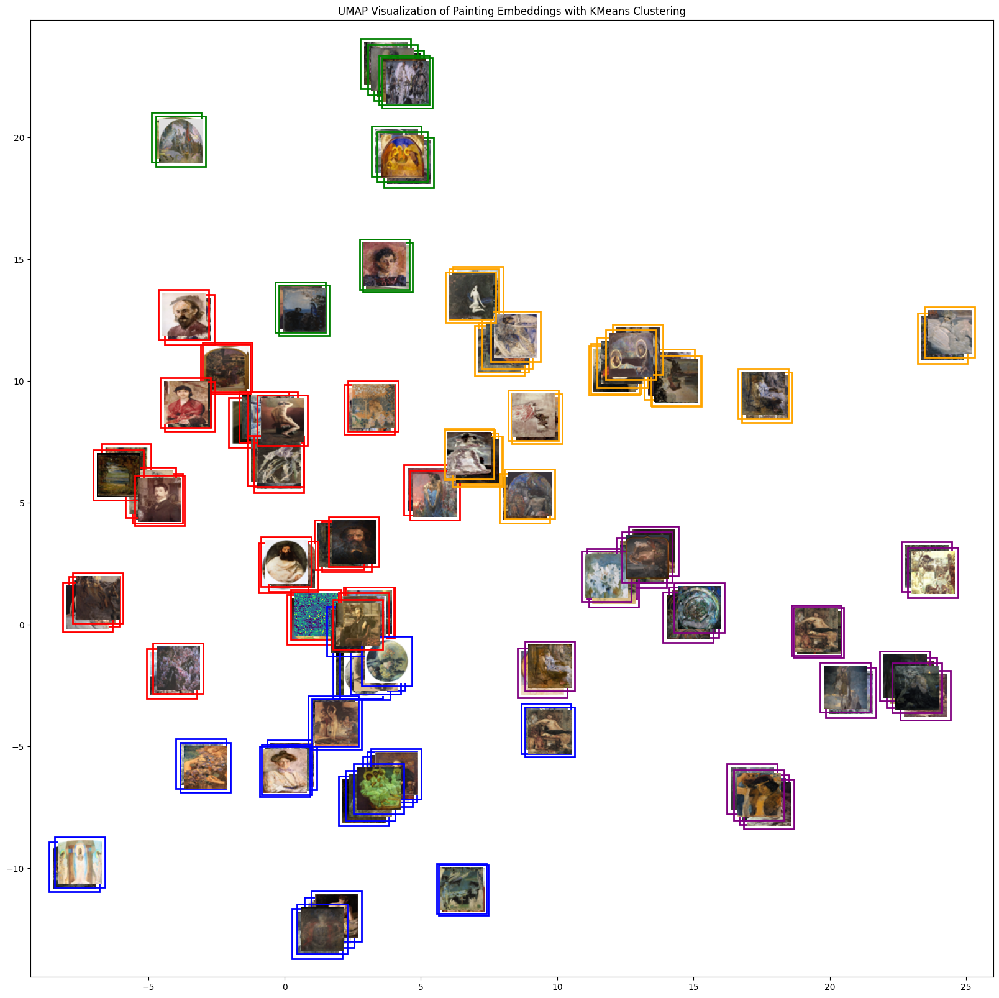

In [98]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange'  # Cluster 4
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(embeddings_2d):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[cluster_labels[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Теги и вектора resnet50

In [223]:
all_dict = {}

for i in vecs_resnet50:
    try:
        all_dict[i] = {'vec': vecs_resnet50[i],
                    'tags': data_dict[i]
        }
    except:
        continue
    
len(all_dict)

210

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


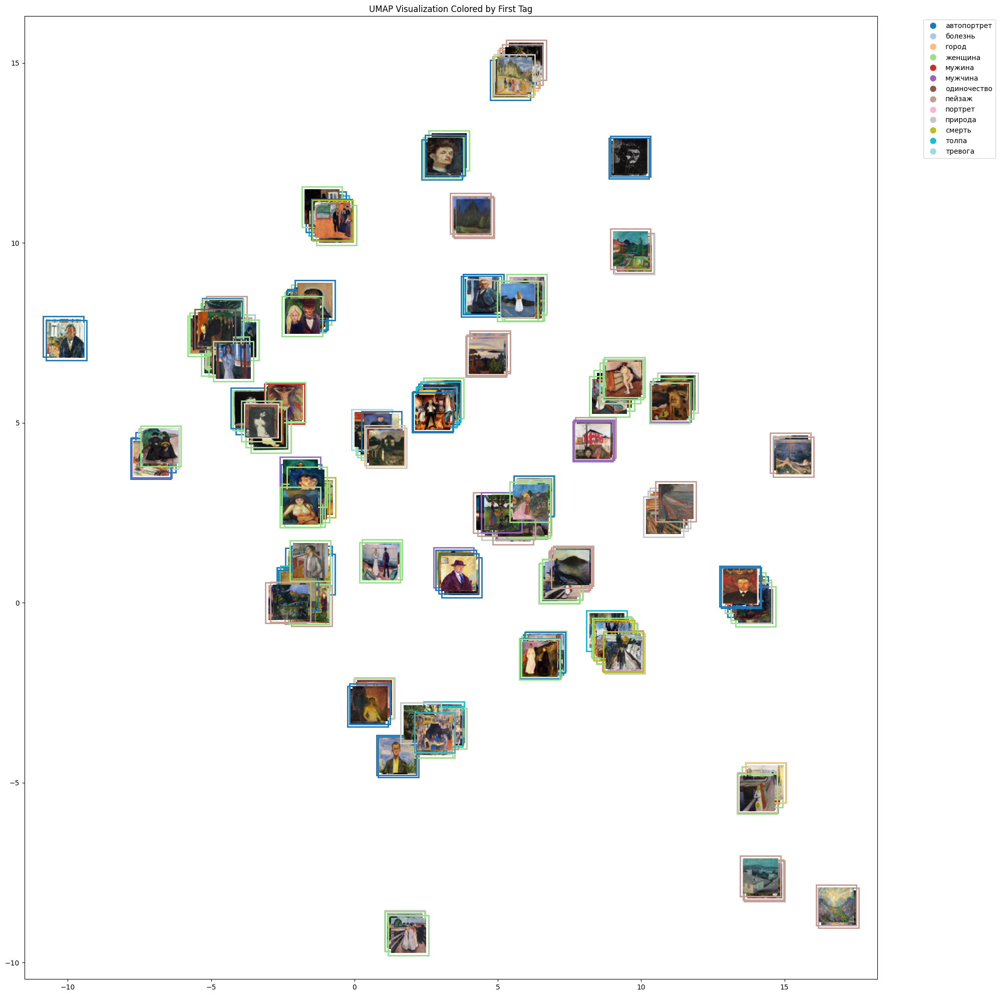

In [224]:
vecs = []
filenames = []

for fname, data in all_dict.items():
    vec = np.array(data['vec'])
    if vec.ndim > 1:
        vec = vec[0]  # взять первую строку, если это массив
    vecs.append(vec)
    filenames.append(fname)

vector_lengths = [v.shape[0] for v in vecs]
if len(set(vector_lengths)) > 1:
    max_len = max(vector_lengths)
    vecs_padded = np.zeros((len(vecs), max_len), dtype=np.float32)
    for i, v in enumerate(vecs):
        vecs_padded[i, :v.shape[0]] = v
    vecs = vecs_padded
else:
    vecs = np.vstack(vecs)

reducer = umap.UMAP(
    n_neighbors=2,
    n_components=2,
    metric='cosine',
    min_dist=0.35,
    spread=0.35,
    random_state=42
)
embeddings_2d = reducer.fit_transform(vecs)

all_tags = set()
for fname in filenames:
    tags = all_dict[fname]['tags']
    if tags:
        first_tag = tags[0] if isinstance(tags, (list, tuple)) else tags
        all_tags.add(first_tag)

unique_tags = sorted(list(all_tags))
tag_colors = plt.cm.tab20(np.linspace(0, 1, len(unique_tags)))
tag_to_color = {tag: color for tag, color in zip(unique_tags, tag_colors)}

plt.figure(figsize=(20, 20))
ax = plt.gca()

for i, (x, y) in enumerate(embeddings_2d):
    fname = filenames[i]
    path = os.path.join(path_munch_pics, fname)
    
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        tags = all_dict[fname]['tags']
        first_tag = tags[0] if isinstance(tags, (list, tuple)) and tags else tags
        color = tag_to_color.get(first_tag, 'gray')

        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(
                edgecolor=color,
                linewidth=2,
                facecolor='none'
            )
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

legend_handles = [
    plt.Line2D([0], [0], marker='o', color='w', 
               markerfacecolor=color, markersize=10, label=tag)
    for tag, color in tag_to_color.items()
]
plt.legend(handles=legend_handles, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)
plt.title("UMAP Visualization Colored by First Tag")
plt.tight_layout()
plt.show()

## Векторы VGG19

In [99]:
filenames = list(i for i in vecs_vgg19)
vectors = np.array([np.array(v).flatten() for v in vecs_vgg19.values()])

In [100]:
colors = []
for filename in vecs_vgg19.keys():
    if filename.split('_')[0] == 'yyyy': # blue - before treatment
        colors.append('blue')
    elif int(filename.split('_')[0]) < 1819:
        colors.append('blue')
    else:
        colors.append('red') # red - after treatment

#### KMeans

In [101]:
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
labels_kmeans = kmeans.fit_predict(vectors)

pca = PCA(n_components=2)
reduced_vectors = pca.fit_transform(vectors)

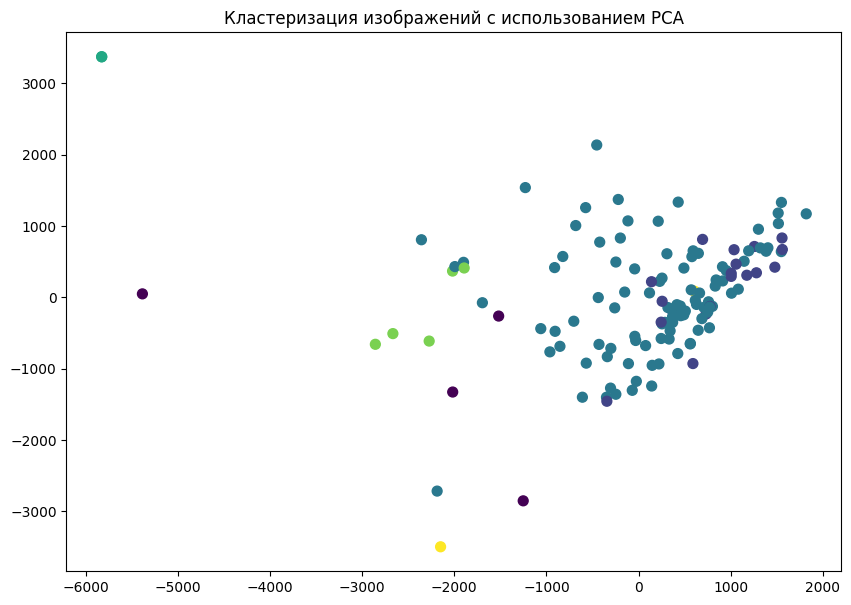

In [102]:
plt.figure(figsize=(10, 7))
scatter = plt.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], c=labels_kmeans, cmap='viridis', s=50)

# for i, label in enumerate(filenames):
#     x, y = reduced_vectors[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.title('Кластеризация изображений с использованием PCA')
plt.show()

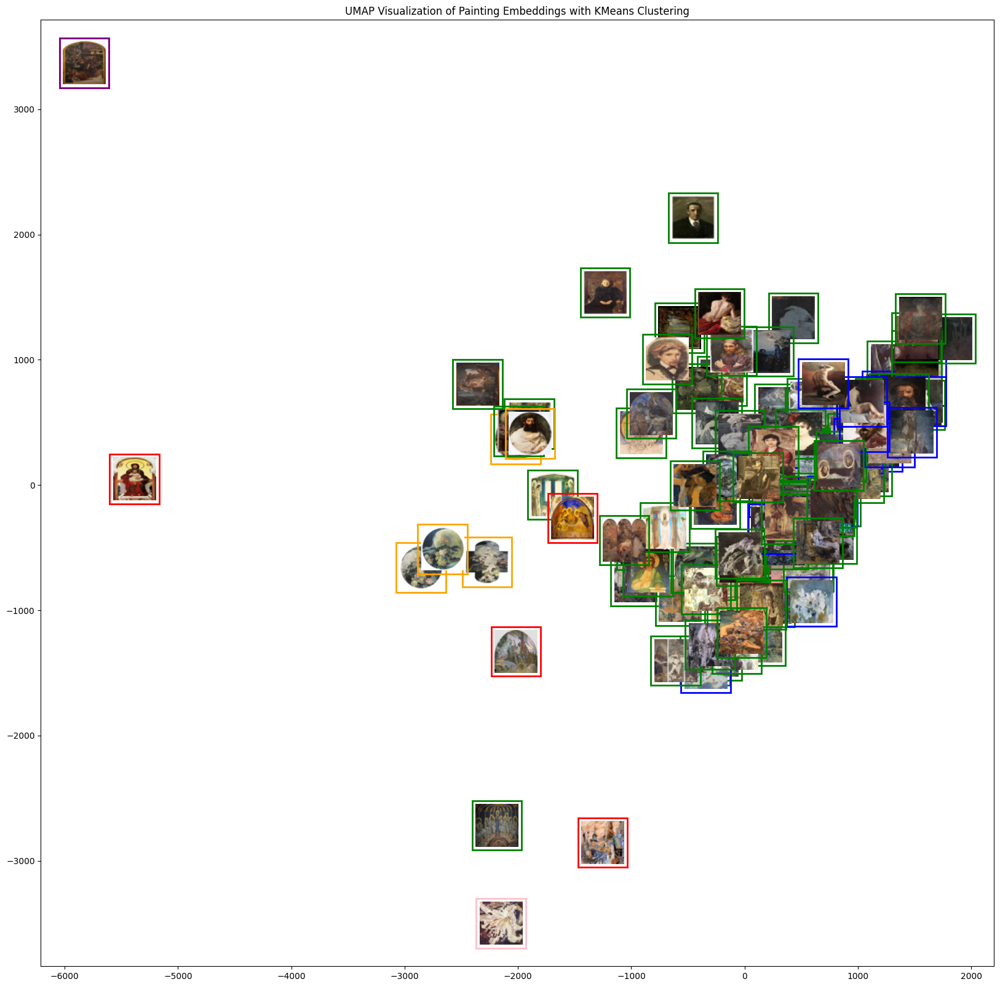

In [103]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange',  # Cluster 4
    'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(reduced_vectors):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[labels_kmeans[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(reduced_vectors[:, 0], reduced_vectors[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Mean Shift

In [105]:
X_scaled = StandardScaler().fit_transform(vectors)

ms = MeanShift(bin_seeding=True)
labels_ms = ms.fit_predict(X_scaled)

In [106]:
unique_labels = np.unique(labels_ms)
n_clusters = len(unique_labels)
print(f"Найдено кластеров: {n_clusters}")

Найдено кластеров: 1


/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
/var/folders/60/_l0csbys1fb0_r6rqk2whzgh0000gn/T/ipykernel_9308/1877909753.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


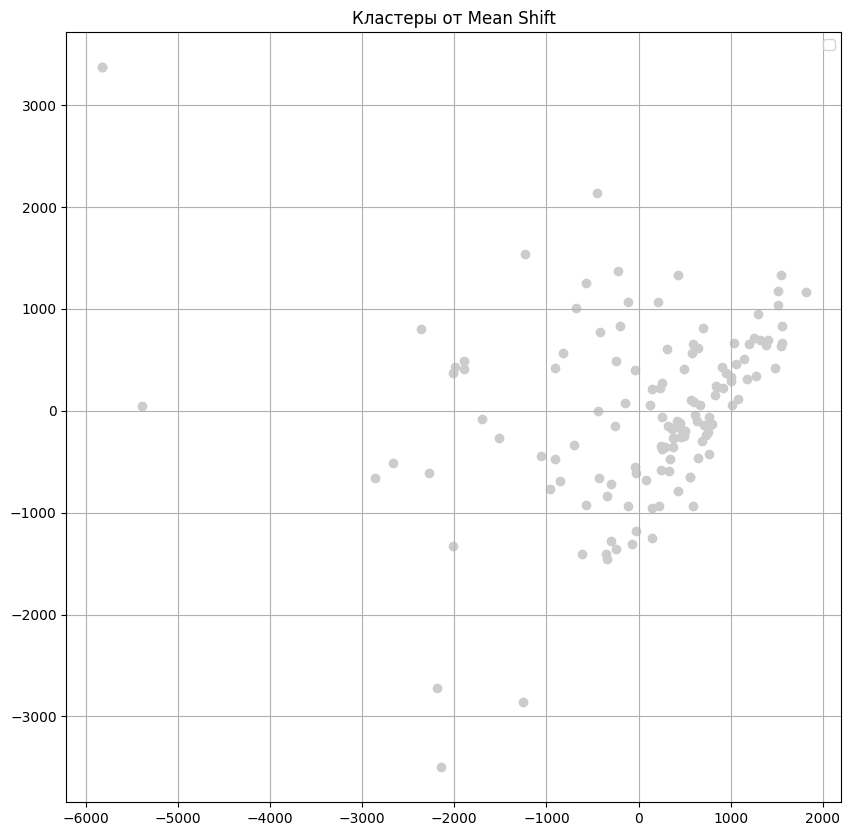

In [107]:
cmap = plt.cm.get_cmap('nipy_spectral', n_clusters)
colors = cmap(np.arange(n_clusters))

plt.figure(figsize=(10, 10))
for idx, label in enumerate(unique_labels):
    mask = labels_ms == label
    plt.scatter(reduced_vectors[mask, 0], reduced_vectors[mask, 1], 
                color=colors[idx]) #, label=f'Кластер {label}', s=50)

plt.title("Кластеры от Mean Shift")

# for i, filename in enumerate(filenames):
#     plt.annotate(filename, (reduced_vectors[i, 0], reduced_vectors[i, 1]), fontsize=8, alpha=0.7)

plt.legend()
plt.grid(True)
plt.show()

#### Spectral Clustering

In [108]:
spectral = SpectralClustering(
                            n_clusters=4, 
                            affinity='nearest_neighbors', 
                            assign_labels='kmeans', 
                            random_state=42
                            )
clusters = spectral.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

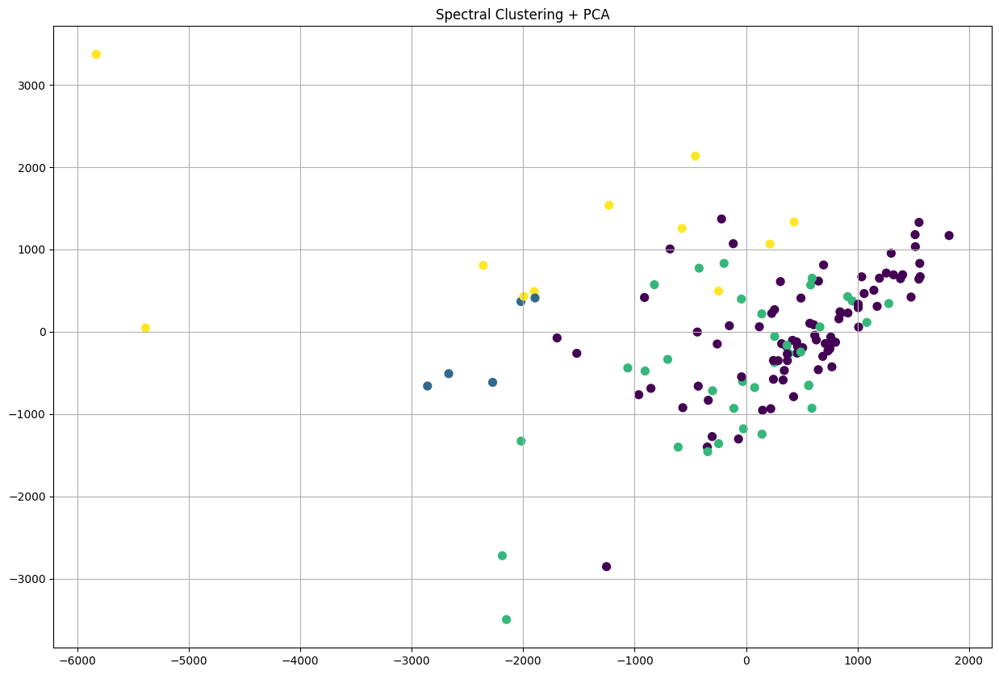

In [109]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Spectral Clustering + PCA')
plt.grid(True)
plt.show()

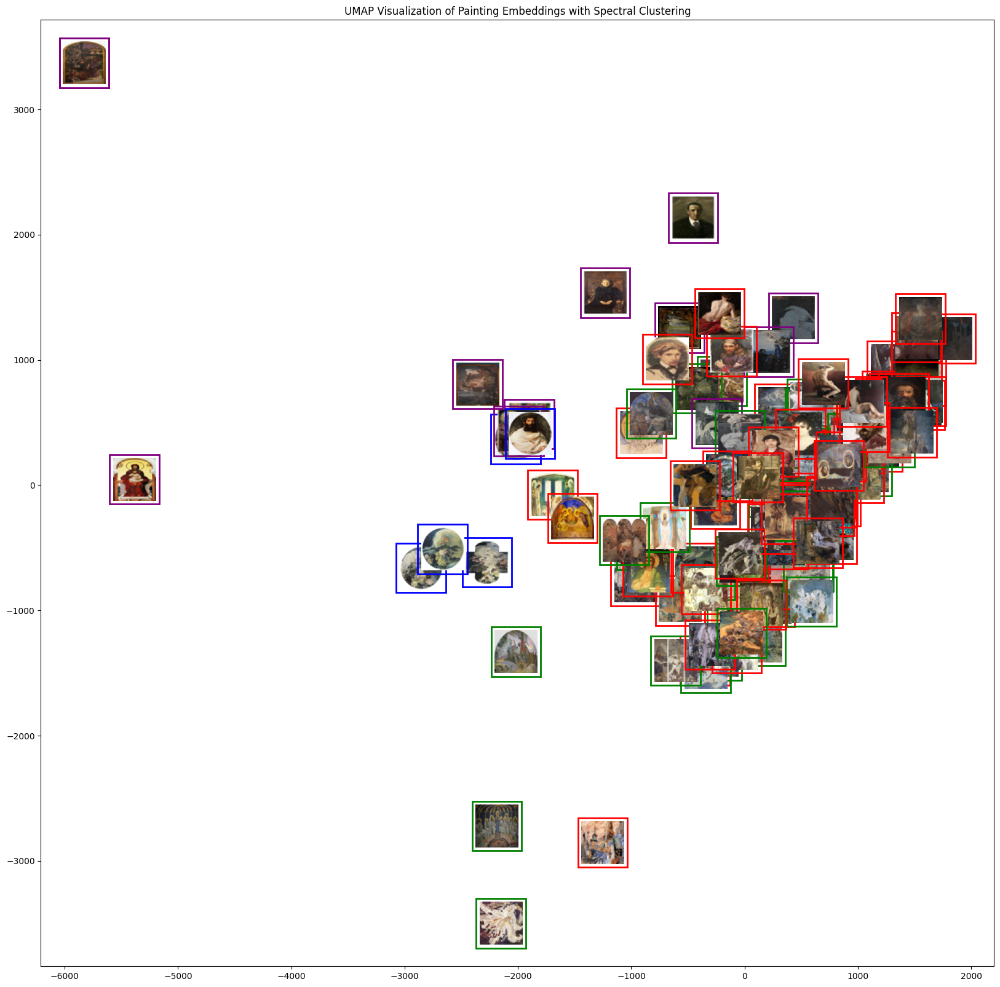

In [110]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Spectral Clustering")
plt.show()

#### Gaussian Mixture

In [111]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

gmm = GaussianMixture(n_components=2, random_state=0)
gmm.fit(X_reduced)
clusters_gmm = gmm.predict(X_reduced)

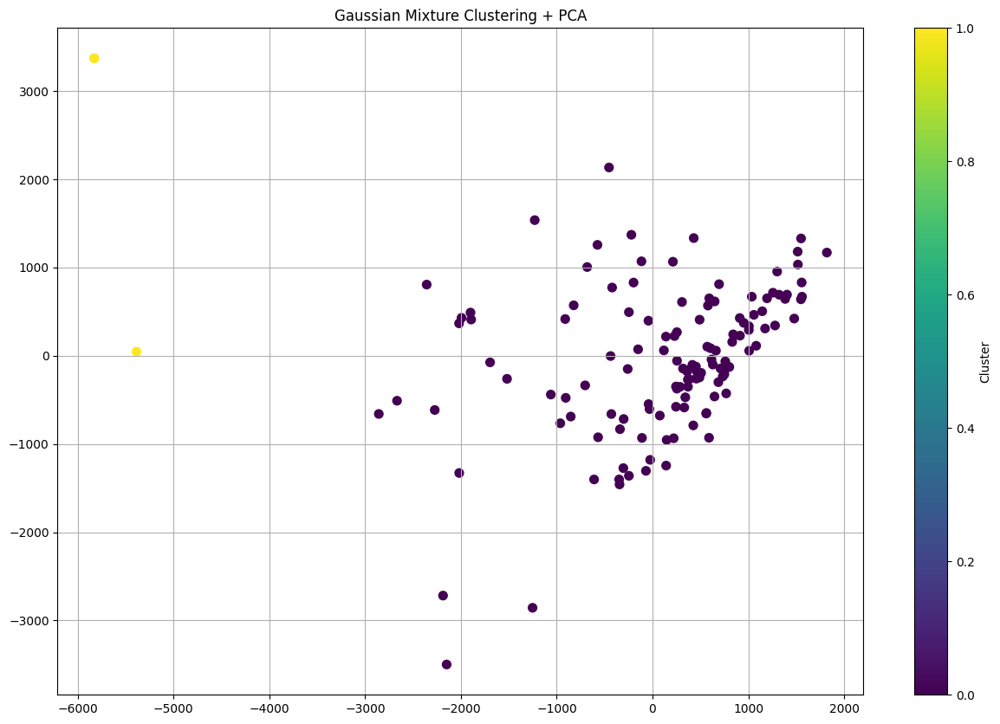

In [112]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_gmm, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Gaussian Mixture Clustering + PCA')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

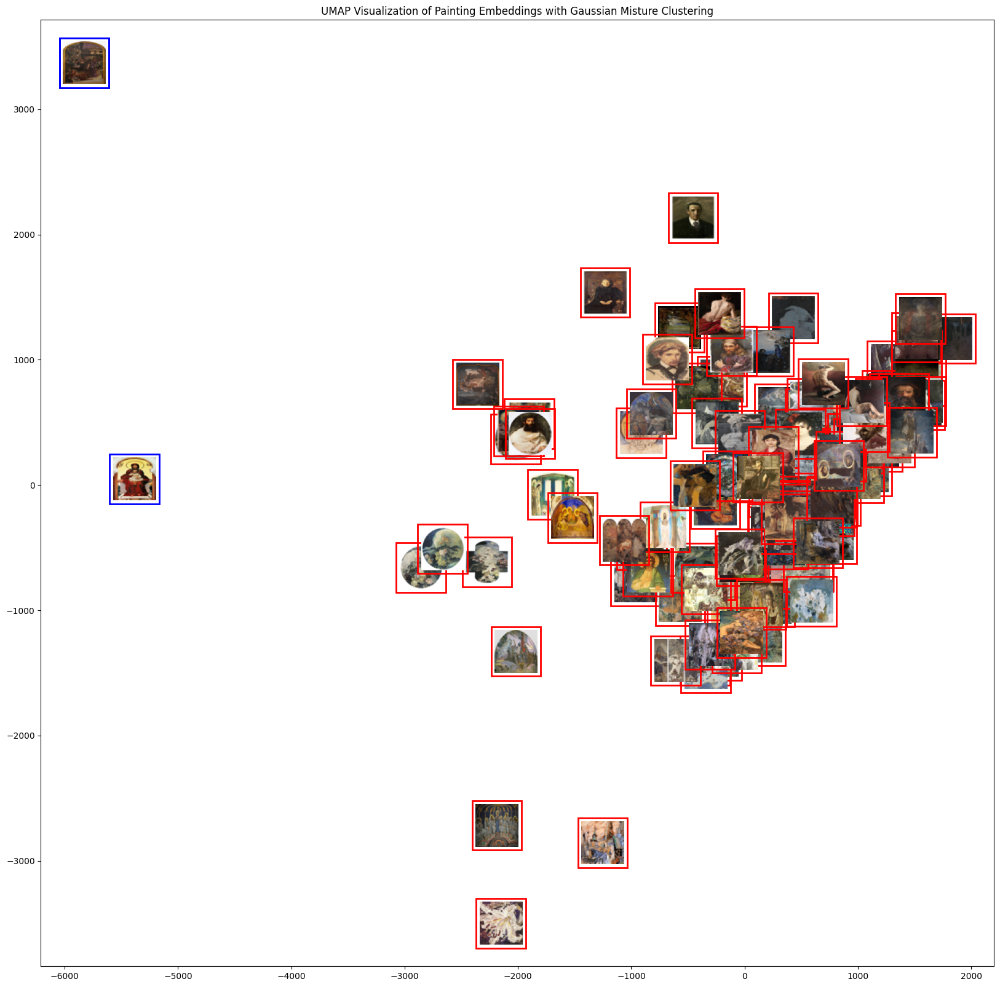

In [113]:
cluster_colors = [
    'red',    # Cluster 0
    'blue'   # Cluster 1
    # 'green',  # Cluster 2
    # 'purple', # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_gmm[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Gaussian Misture Clustering")
plt.show()

#### Birch

In [114]:
birch = Birch(n_clusters=4)
clusters_birch = birch.fit_predict(vectors)

pca = PCA(n_components=2)
X_reduced = pca.fit_transform(vectors)

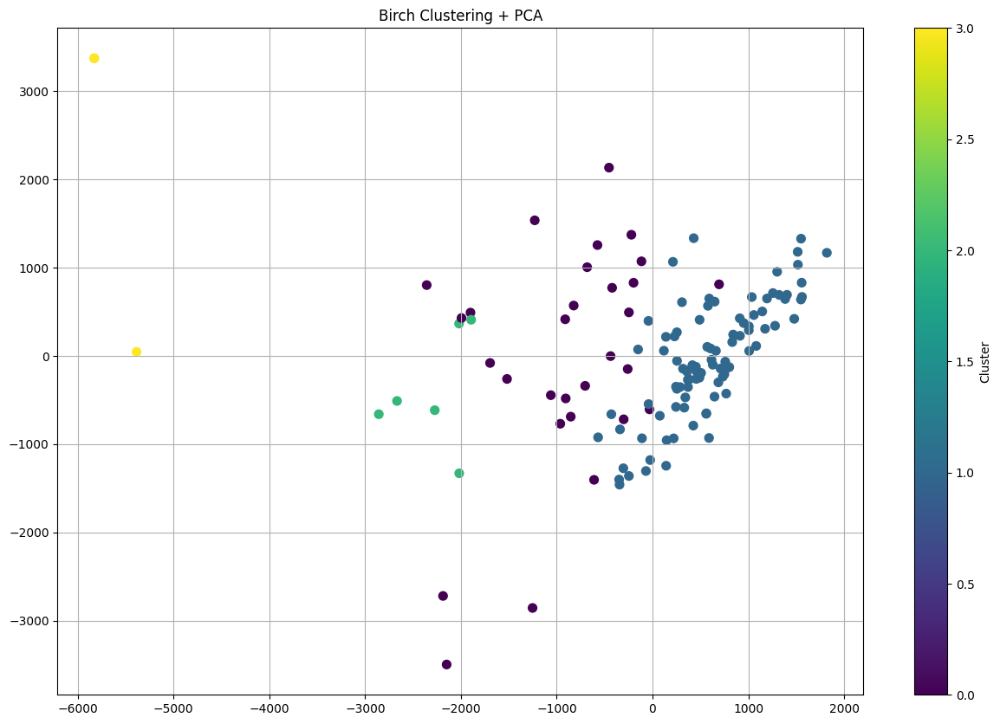

In [115]:
plt.figure(figsize=(15, 10))
scatter = plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=clusters_birch, cmap='viridis', s=50)

# for i, label in enumerate(labels):
#     x, y = X_reduced[i]
#     plt.text(x + 0.02, y + 0.02, str(label), fontsize=8)

plt.title('Birch Clustering + PCA')
plt.colorbar(scatter, label='Cluster')
plt.grid(True)
plt.show()

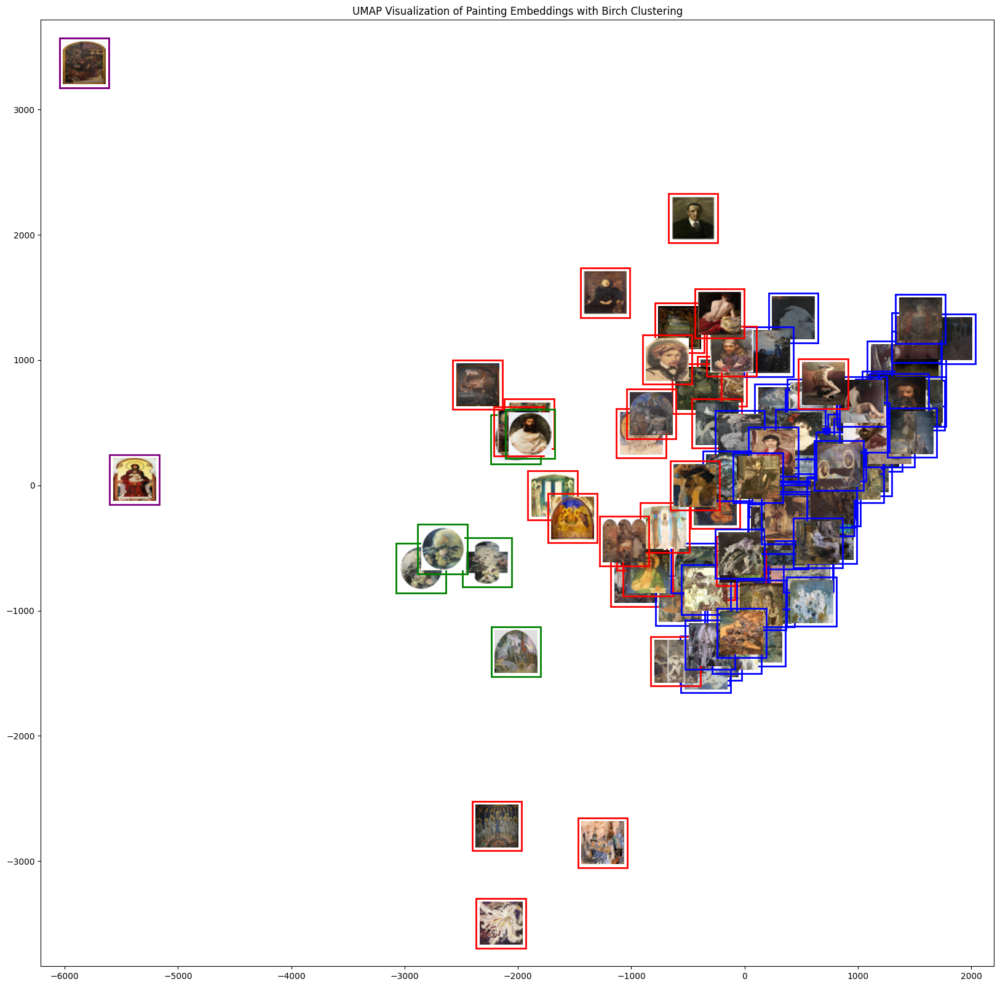

In [116]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple' # Cluster 3
    # 'orange',  # Cluster 4
    # 'pink',   # Cluster 5
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(X_reduced):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[clusters_birch[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(X_reduced[:, 0], X_reduced[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with Birch Clustering")
plt.show()

#### Кластеризация с Umap

In [117]:
filenames = list(vecs_vgg19.keys())
# vecs = np.array([vecs_vgg19[fname][0] for fname in filenames]).astype(np.float32)
vecs = np.array([vecs_vgg19[filename] for filename in vecs_vgg19])

pca = PCA(n_components=3)
vecs = pca.fit_transform(vecs)

vector_lengths = [vecs[i].shape[0] for i in range(len(vecs))]

In [118]:
reducer = umap.UMAP(
            n_neighbors=2,
            n_components=2, #25, 17
            metric='cosine', 
            min_dist=0.55,
            spread=0.57, #1.7, #0.57,
            random_state=42
            )

embeddings_2d = reducer.fit_transform(vecs)

kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(embeddings_2d)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


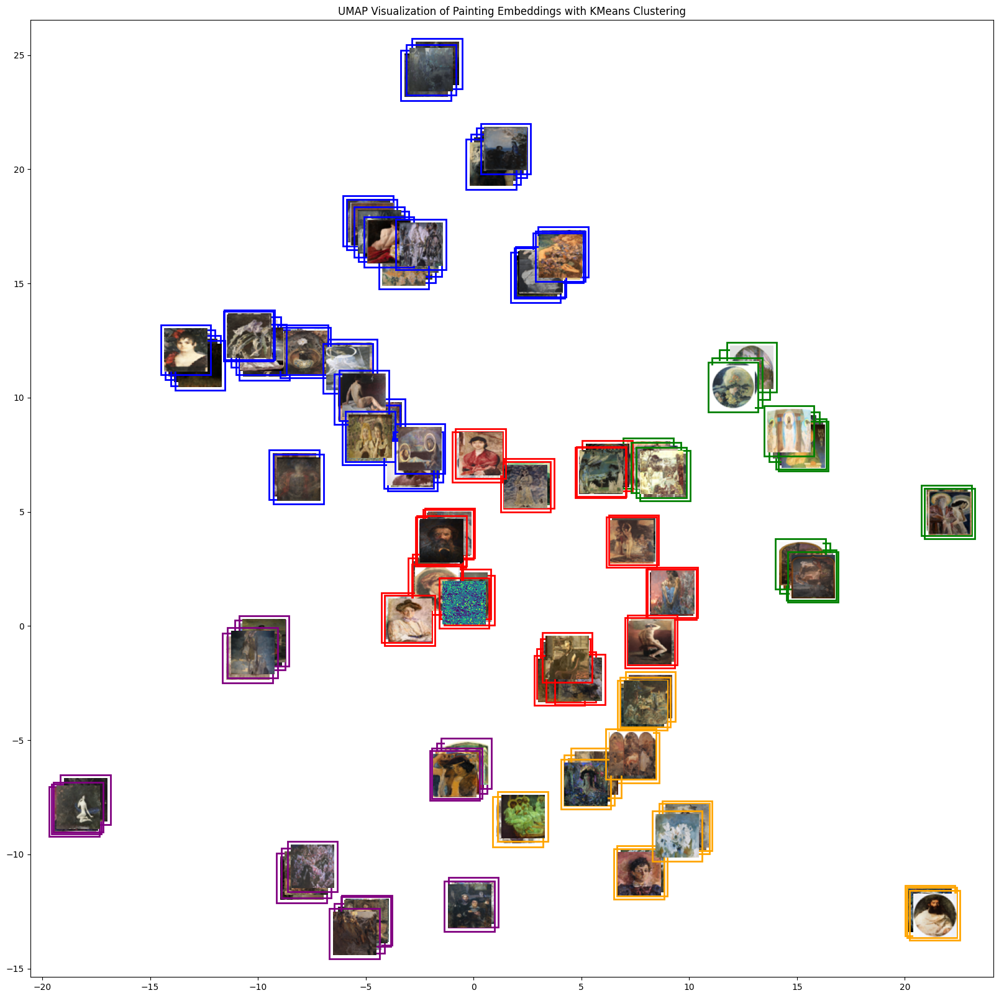

In [119]:
cluster_colors = [
    'red',    # Cluster 0
    'blue',   # Cluster 1
    'green',  # Cluster 2
    'purple', # Cluster 3
    'orange'  # Cluster 4
]

fig, ax = plt.subplots(figsize=(20, 20))
for i, (x, y) in enumerate(embeddings_2d):
    path = os.path.join(path_pics, filenames[i])
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(edgecolor=cluster_colors[cluster_labels[i]], linewidth=2, facecolor='none')
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

ax.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)  # Invisible scatter for axes
plt.title("UMAP Visualization of Painting Embeddings with KMeans Clustering")
plt.show()

#### Теги и вектора VGG19

In [252]:
all_dict = {}

for i in vecs_vgg19:
    try:
        all_dict[i] = {'vec': vecs_vgg19[i],
                    'tags': data_dict[i]
        }
    except:
        continue
    
len(all_dict)

210

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


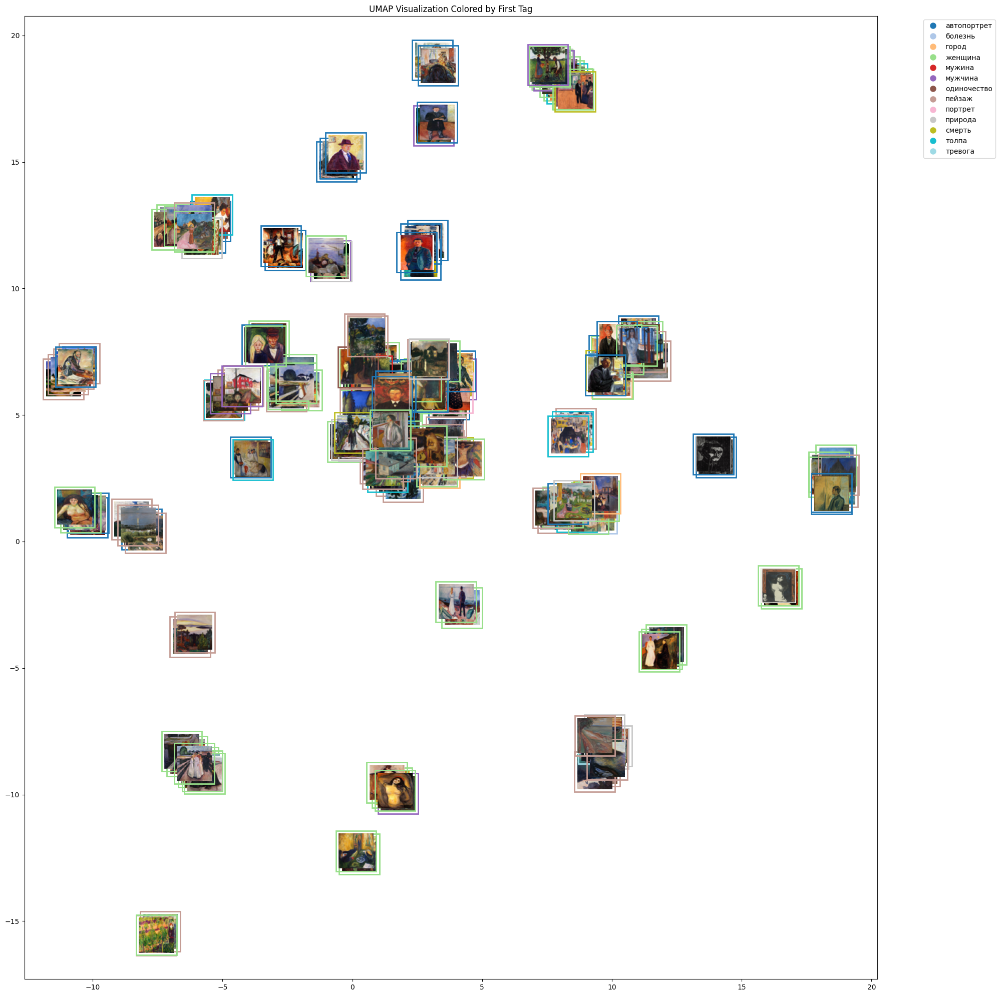

In [253]:
vecs = []
filenames = []

for fname, data in all_dict.items():
    vec = np.array(data['vec'])
    if vec.ndim > 1:
        vec = vec[0]  # взять первую строку, если это массив
    vecs.append(vec)
    filenames.append(fname)

vector_lengths = [v.shape[0] for v in vecs]
if len(set(vector_lengths)) > 1:
    max_len = max(vector_lengths)
    vecs_padded = np.zeros((len(vecs), max_len), dtype=np.float32)
    for i, v in enumerate(vecs):
        vecs_padded[i, :v.shape[0]] = v
    vecs = vecs_padded
else:
    vecs = np.vstack(vecs)

reducer = umap.UMAP(
            n_neighbors=2,
            n_components=2, #25, 17
            metric='cosine', 
            min_dist=0.55,
            spread=0.57, #1.7, #0.57,
            random_state=42
            )
embeddings_2d = reducer.fit_transform(vecs)

all_tags = set()
for fname in filenames:
    tags = all_dict[fname]['tags']
    if tags:
        first_tag = tags[0] if isinstance(tags, (list, tuple)) else tags
        all_tags.add(first_tag)

unique_tags = sorted(list(all_tags))
tag_colors = plt.cm.tab20(np.linspace(0, 1, len(unique_tags)))
tag_to_color = {tag: color for tag, color in zip(unique_tags, tag_colors)}

plt.figure(figsize=(20, 20))
ax = plt.gca()

for i, (x, y) in enumerate(embeddings_2d):
    fname = filenames[i]
    path = os.path.join(path_munch_pics, fname)
    
    if os.path.exists(path):
        img = Image.open(path).resize((50, 50))
        imagebox = OffsetImage(img, zoom=1)
        tags = all_dict[fname]['tags']
        first_tag = tags[0] if isinstance(tags, (list, tuple)) and tags else tags
        color = tag_to_color.get(first_tag, 'gray')

        ab = AnnotationBbox(
            imagebox, (x, y),
            frameon=True,
            bboxprops=dict(
                edgecolor=color,
                linewidth=2,
                facecolor='none'
            )
        )
        ax.add_artist(ab)
    else:
        print(f"Image not found: {path}")

legend_handles = [
    plt.Line2D([0], [0], marker='o', color='w', 
               markerfacecolor=color, markersize=10, label=tag)
    for tag, color in tag_to_color.items()
]
plt.legend(handles=legend_handles, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0)
plt.title("UMAP Visualization Colored by First Tag")
plt.tight_layout()
plt.show()